In [ ]:
# Run the Three Cells Below Before Continuing From a Project Checkpoint

In [ ]:
!pip install datasets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 480.6/480.6 kB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 588.7 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.3/179.3 kB 1.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.5/143.5 kB 12.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.8/194.8 kB 14.7 MB/s eta 0:00:00
  Attempting uninstall: fsspec
    Found existing installation: fsspec 2024.10.0
    Uninstalling fsspec-2024.10.0:
      Successfully uninstalled fsspec-2024.10.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2024.10.0 requires fsspec==2024.10.0, but you have fsspec 2024.9.0 which is incompatible.
torch 2.5.1+cu124 requires nvidia-cublas-cu12==12.4.5.8; platform_system == "Linux" and platform_machine == "x86_64", but you have nvidia-cublas-cu12 12.5.3.2 wh

In [ ]:
import numpy as np
np.random.seed(17)
import torch
torch.manual_seed(17)
from transformers import set_seed
set_seed(17)

import matplotlib.pyplot as plt

In [ ]:
import os

# Running on a GPU is recommended
device =  "cuda" if torch.cuda.is_available() else "xla" if "COLAB_TPU_ADDR" in os.environ else "cpu"

# FADE: A Novel Approach for Fake Image Detection

***Martin Shopov***<br>
*Sofia High School of Mathematics; SoftUni*

In this notebook, I will present and test a unique approach, which can be used to create state-of-art models designed for fake (generated) image detection. The method is called **Fake and Authentic Discrimination by Embeddings (FADE)**. It is based on fine-tuning transformers using contrastive learning.

The models and datasets associated with Project Checkpoints are located [here](https://drive.google.com/drive/folders/15htKJGVM-C02koeV4tnB93urthV4qCXv?usp=sharing).

## Table of Contents

1. Introduction and Objectives
2. Related Work
3. Data Loading and Preparation
4. Image Captioning
5. Image Generation from Captions
6. Contrastive Learning for Fine-Tuning
7. Real vs. Fake Image Classification
8. Summary and Findings
9. Future Directions and Improvements

## 1. Introduction and Objectives

As the quality of generated images improves exponentially, the need for models that correctly classify them as "real" or "generated" also rises. In this work, I would like to present a novel method for training such models. I am going to test it and decide whether the hypothesis that this method is better (in terms of accuracy and/or efficiency) is true. **The goal of this project itself is not to create a state-of-art model but rather to perform a Proof of Concept (PoC).** The experiments of the project will be conducted using the resources provided by the Free Version of Google Colab. These come with several limitations but it is expected for them to be enough to perform PoC.

As mentioned, the new approach is called **Fake and Authentic Discrimination by Embeddings (FADE)**. In short, the structure behind the methodology of FADE is as follows:

The first step is to find and load a dataset consisting of *real* images only. Using a transformer, we create captions for these images, which are then used to generate *fake* images using another transformer. The next (arguably the most crucial) step is to slightly fine-tune an embedding model to create different embeddings for real and generated images, while also preserving their meaning. The fine-tuning will be based on *contrastive learning*. The final part of the method is to freeze the embedder and attach a head to it, which will be used for the classification.

Throughout the notebook, we will go into more detail for each step.

Similar approaches have been discovered and related research has been conducted. Nonetheless, FADE has not yet been tested.

## 2. Related Work

In this section, we are going to have a look at some of the research based on Fake Image Detection.

### 2.1 Generative Adversarial Networks (GANs)

Originally introduced by Goodfellow et al. (2014), GANs are a state-of-art framework for both generation of high-quality images and their classification as "real" or "fake". It consists of two networks trained in opposition: a generator, which synthesizes images, and a discriminator, which attempts to distinguish real images from generated ones. The discriminator’s role is particularly relevant to fake image detection (our task), as its objective aligns closely with the task of separating real and fake images.

<img src="https://miro.medium.com/v2/resize:fit:1400/1*t78gwhhw-hn1CgXc1K89wA.png" width="500"/>

Nevertheless, GANs struggle with several problems. One issue is mode collapse, where the generator produces a limited variety of outputs, focusing on a small subset of the data distribution. GANs also struggle with non-convergence, where one model may overpower the other, preventing the system from reaching equilibrium and generating realistic outputs. Generally, GANs are relatively hard to train. Also, they do not tend to use constrastive learning, which will be our approach.



### 2.2 DeepFake Detection

Deepfake is synthetic media generated using deep learning techniques, particularly GANs and variational autoencoders (VAEs). These models manipulate or create realistic images and videos, often altering facial expressions, replacing identities, or synthesizing entirely artificial visuals. Deepfake detection methods primarily focus on identifying artifacts, inconsistencies, or unnatural patterns in generated content using convolutional neural networks (CNNs), vision transformers, etc. These methods leverage spatial and temporal features, frequency analysis, and physiological cues to distinguish real from manipulated media.

<img src="https://www.mdpi.com/mathematics/mathematics-11-03952/article_deploy/html/images/mathematics-11-03952-g001.png" width="400"/>

Deepfake detection has notable strengths, including its success in identifying tampered videos or faces in high-resolution images. Many approaches effectively detect artifacts left by deepfake generators, such as unnatural eye blinking, misaligned shadows, and texture inconsistencies. However, these methods also have weaknesses, particularly in their vulnerability to adversarial attacks, dataset biases, and their reliance on known deepfake generation techniques. As generative models become more sophisticated, deepfake detection struggles to keep up, especially with highly realistic content.

Unlike traditional deepfake detection, which focuses on identifying manipulation within specific content types (e.g., faces in videos), our approach aims to distinguish real from generated images in a broader context using contrastive learning. Instead of detecting specific artifacts or patterns tied to deepfake synthesis methods, FADE learns general representations that separate authentic and AI-generated content based on their feature embeddings. This allows the method to extend beyond deepfake detection and apply to various forms of synthetic media, making it potentially more robust against evolving generative techniques.

### 2.3 Rich and Poor Texture Contrast

In the paper "Rich and Poor Texture Contrast: A Simple yet Effective Approach for AI-generated Image Detection" by Nan Zhong et al. (2023), the authors propose a method that analyzes texture regions in images to distinguish between real and AI-generated content. Their approach focuses on detecting differences in the texture distribution between rich and poor texture (visual patterns formed by variations in pixel intensity) regions. Rich texture areas have complex, high-frequency patterns, while poor texture areas are more uniform and lack intricate details. The method enhances texture patches through a technique called Smash&Reconstruction, which emphasizes the detection of these textural discrepancies by suppressing global semantic information. This allows the model to better capture subtle differences between real and generated images.

The strengths of their approach lie in its simplicity and effectiveness, as it does not rely on complex deep learning models or feature extraction techniques. It performs well across different generative models and outperforms many state-of-the-art detection methods. By focusing on texture contrasts, it leverages a feature that generative models often struggle to replicate accurately, especially in high-detail regions. Below is a table showing the results of their approach. In it, **we can also see the results of other models and methods** used for fake image detection.

|  Generator | CNNSpot | FreDect | Fusing | GramNet |  LNP  | LGrad | DIRE-G | DIRE-D | UnivFD | Their  |
|:----------:|:-------:|:-------:|:------:|:-------:|:-----:|:-----:|:------:|:------:|:------:|:------:|
|   ProGAN   |  100.00 |  99.36  | 100.00 |  99.99  | 99.67 | 99.83 |  95.19 |  52.75 |  99.81 | 100.00 |
|  StyleGan  |  90.17  |  78.02  |  85.20 |  87.05  | 91.75 | 91.08 |  83.03 |  51.31 |  84.93 |  92.77 |
|   BigGAN   |  71.17  |  81.97  |  77.40 |  67.33  | 77.75 | 85.62 |  70.12 |  49.70 |  95.08 |  95.80 |
|  CycleGAN  |  87.62  |  78.77  |  87.00 |  86.07  | 84.10 | 86.94 |  74.19 |  49.58 |  98.33 |  70.17 |
|   StarGAN  |  94.60  |  94.62  |  97.00 |  95.05  | 99.92 | 99.27 |  95.47 |  46.72 |  95.75 |  99.97 |
|   GauGAN   |  81.42  |  80.57  |  77.00 |  69.35  | 75.39 | 78.46 |  67.79 |  51.23 |  99.47 |  71.58 |
|  Stylegan2 |  86.91  |  66.19  |  83.30 |  87.28  | 94.64 | 85.32 |  75.31 |  51.72 |  74.96 |  89.55 |
|    WFIR    |  91.65  |  50.75  |  66.80 |  86.80  | 70.85 | 55.70 |  58.05 |  53.30 |  86.90 |  85.80 |
|     ADM    |  60.39  |  63.42  |  49.00 |  58.61  | 84.73 | 67.15 |  75.78 |  98.25 |  66.87 |  82.17 |
|    Glide   |  58.07  |  54.13  |  57.20 |  54.50  | 80.52 | 66.11 |  71.75 |  92.42 |  62.46 |  83.79 |
| Midjourney |  51.39  |  45.87  |  52.20 |  50.02  | 65.55 | 65.35 |  58.01 |  89.45 |  56.13 |  90.12 |
|   SDv1.4   |  50.57  |  38.79  |  51.00 |  51.70  | 85.55 | 63.02 |  49.74 |  91.24 |  63.66 |  95.38 |
|   SDv1.5   |  50.53  |  39.21  |  51.40 |  52.16  | 85.67 | 63.67 |  49.83 |  91.63 |  63.49 |  95.30 |
|    VQDM    |  56.46  |  77.80  |  55.10 |  52.86  | 74.46 | 72.99 |  53.68 |  91.90 |  85.31 |  88.91 |
|   Wukong   |  51.03  |  40.30  |  51.70 |  50.76  | 82.06 | 59.55 |  54.46 |  90.90 |  70.93 |  91.07 |
|   DALLE2   |  50.45  |  34.70  |  52.80 |  49.25  | 88.75 | 65.45 |  66.48 |  92.45 |  50.75 |  96.60 |
| **Average** |  **70.78**  |  **64.03**  |  **68.38** |  **68.67**  | **83.84** | **75.34** |  **68.68** |  **71.53** |**78.43**|**89.31**|

As we can witness from the table, most of the mentioned models and methods tend to **not** give satisfying results on most of the generative models (except the approach suggested by the authors). Here is the data used for evaluating the approach proposed by the authors:

| Generative model |    Size   | Number |  Source  |
|:----------------:|:---------:|:------:|:--------:|
|    ProGAN    |  256×256  |  8.0k  |   LSUN   |
|   StyleGAN  |  256×256  |  12.0k |   LSUN   |
|    BigGAN     |  256×256  |  4.0k  | ImageNet |
|   CycleGAN  |  256×256  |  2.6k  | ImageNet |
|    StarGAN   |  256×256  |  4.0k  |  CelebA  |
|    GauGAN    |  256×256  |  10.0k |   COCO   |
|  Stylegan2   |  256×256  |  15.9k |   LSUN   |
|     WFIR    | 1024×1024 |  2.0k  |   FFHQ   |
|      ADM     |  256×256  |  12.0k | ImageNet |
|    Glide   |  256×256  |  12.0k | ImageNet |
|  Midjourney | 1024×1024 |  12.0k | ImageNet |
|    SDv1.4   |  512×512  |  12.0k | ImageNet |
|    SDv1.5   |  512×512  |  16.0k | ImageNet |
|     VQDM    |  256×256  |  12.0k | ImageNet |

Despite its high accuracy, the weaknesses of this method include its limitations in handling artificially generated images with more sophisticated models that can better mimic texture patterns. Furthermore, the method might not be as effective for detecting subtle or low-resolution images, where texture distinctions may be harder to identify.

This approach differs from our FADE method in that it relies on texture-based features, focusing specifically on detecting rich and poor texture contrasts, while our method uses contrastive learning to learn more general feature embeddings that separate real and generated images. FADE’s broader application to various forms of synthetic media and its reliance on a pre-trained transformer model for feature extraction give it a distinct advantage in capturing complex, high-dimensional patterns beyond just texture discrepancies.

### 2.4 Other Related Approaches

The related topics in one of the most renowned websites [PapersWithCode](https://paperswithcode.com/) in the AI field include 'Synthetic Image Detection' and 'Fake Image Detection' (and 'DeepFake Detection', alreade discussed in 2.2). Nevertheless, these topics are yet to be extended enough and a lack of state-of-art models is obvious (except for 'DeepFake Detection', already discussed in 2.2). Our aim is to contribute to the advancement of these fields through deeper investigation and meaningful research.

### 2.5* Contrastive Language-Image Pretraining (CLIP)

CLIP (Contrastive Language-Image Pretraining) is a deep learning model developed by OpenAI that connects vision and language by learning to associate images with their corresponding textual descriptions. It is trained on a large dataset of images paired with text, using a contrastive learning approach, where the model learns to match the correct image-text pairs while distinguishing incorrect ones, relying on the fact that an image corresponds only to its own caption.

<img src="https://miro.medium.com/v2/resize:fit:1400/1*P-wDfY9K1DceIHyIkc1p0g.jpeg" width="500"/>

The connection to our model lies in the use of contrastive learning (mainly) and the pairing of images and text (such as when creating captions). However, CLIP was not designed specifically for fake image detection.

In conclusion, previous research on fake image detection across various objects remains underdeveloped. With the introduction of a novel approach, I aim to enhance the quality of detection models and contribute to advancements in the field.

## 3. Data Loading and Preparation

The first step in the PoC for FADE is to load a dataset, which will be utilized throughout each step of the process. The selected dataset, obtained from [HuggingFace](https://huggingface.co/datasets/bitmind/bm-real), contains 28,393 images (total size: 6.71 GB) with varying quality and content. We will not need to plot every image of the dataset to get familiar with it. On its HuggingFace repository we can see the histogram image sizes, as well as the original images. The diversity in content makes it an ideal choice for the project.

However, due to resource limitations in the Free Version of Colab, we will use a subset of 1,000 images. While 1,000 samples may not be sufficient for large-scale deep learning applications, it provides a reasonable trade-off between efficiency and reliability for the goals of this PoC.

In [ ]:
from datasets import load_dataset

real_images = load_dataset("bitmind/bm-real")
real_images = real_images.rename_column("image", "real_image")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


README.md:   0%|          | 0.00/294 [00:00<?, ?B/s]

Resolving data files:   0%|          | 0/45 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/45 [00:00<?, ?it/s]

train-00000-of-00045.parquet:   0%|          | 0.00/465M [00:00<?, ?B/s]

train-00001-of-00045.parquet:   0%|          | 0.00/542M [00:00<?, ?B/s]

train-00002-of-00045.parquet:   0%|          | 0.00/378M [00:00<?, ?B/s]

train-00003-of-00045.parquet:   0%|          | 0.00/304M [00:00<?, ?B/s]

train-00004-of-00045.parquet:   0%|          | 0.00/331M [00:00<?, ?B/s]

train-00005-of-00045.parquet:   0%|          | 0.00/398M [00:00<?, ?B/s]

train-00006-of-00045.parquet:   0%|          | 0.00/451M [00:00<?, ?B/s]

train-00007-of-00045.parquet:   0%|          | 0.00/407M [00:00<?, ?B/s]

train-00008-of-00045.parquet:   0%|          | 0.00/50.3M [00:00<?, ?B/s]

train-00009-of-00045.parquet:   0%|          | 0.00/50.1M [00:00<?, ?B/s]

train-00010-of-00045.parquet:   0%|          | 0.00/48.7M [00:00<?, ?B/s]

train-00011-of-00045.parquet:   0%|          | 0.00/48.4M [00:00<?, ?B/s]

train-00012-of-00045.parquet:   0%|          | 0.00/49.2M [00:00<?, ?B/s]

train-00013-of-00045.parquet:   0%|          | 0.00/48.1M [00:00<?, ?B/s]

train-00014-of-00045.parquet:   0%|          | 0.00/56.1M [00:00<?, ?B/s]

train-00015-of-00045.parquet:   0%|          | 0.00/63.9M [00:00<?, ?B/s]

train-00016-of-00045.parquet:   0%|          | 0.00/62.5M [00:00<?, ?B/s]

train-00017-of-00045.parquet:   0%|          | 0.00/61.1M [00:00<?, ?B/s]

train-00018-of-00045.parquet:   0%|          | 0.00/57.8M [00:00<?, ?B/s]

train-00019-of-00045.parquet:   0%|          | 0.00/53.6M [00:00<?, ?B/s]

train-00020-of-00045.parquet:   0%|          | 0.00/52.2M [00:00<?, ?B/s]

train-00021-of-00045.parquet:   0%|          | 0.00/51.5M [00:00<?, ?B/s]

train-00022-of-00045.parquet:   0%|          | 0.00/43.3M [00:00<?, ?B/s]

train-00023-of-00045.parquet:   0%|          | 0.00/6.60M [00:00<?, ?B/s]

train-00024-of-00045.parquet:   0%|          | 0.00/6.60M [00:00<?, ?B/s]

train-00025-of-00045.parquet:   0%|          | 0.00/6.63M [00:00<?, ?B/s]

train-00026-of-00045.parquet:   0%|          | 0.00/6.61M [00:00<?, ?B/s]

train-00027-of-00045.parquet:   0%|          | 0.00/6.67M [00:00<?, ?B/s]

train-00028-of-00045.parquet:   0%|          | 0.00/6.58M [00:00<?, ?B/s]

train-00029-of-00045.parquet:   0%|          | 0.00/6.66M [00:00<?, ?B/s]

train-00030-of-00045.parquet:   0%|          | 0.00/6.68M [00:00<?, ?B/s]

train-00031-of-00045.parquet:   0%|          | 0.00/6.59M [00:00<?, ?B/s]

train-00032-of-00045.parquet:   0%|          | 0.00/6.60M [00:00<?, ?B/s]

train-00033-of-00045.parquet:   0%|          | 0.00/6.67M [00:00<?, ?B/s]

train-00034-of-00045.parquet:   0%|          | 0.00/6.73M [00:00<?, ?B/s]

train-00035-of-00045.parquet:   0%|          | 0.00/6.66M [00:00<?, ?B/s]

train-00036-of-00045.parquet:   0%|          | 0.00/6.63M [00:00<?, ?B/s]

train-00037-of-00045.parquet:   0%|          | 0.00/6.65M [00:00<?, ?B/s]

train-00038-of-00045.parquet:   0%|          | 0.00/81.8M [00:00<?, ?B/s]

train-00039-of-00045.parquet:   0%|          | 0.00/435M [00:00<?, ?B/s]

train-00040-of-00045.parquet:   0%|          | 0.00/392M [00:00<?, ?B/s]

train-00041-of-00045.parquet:   0%|          | 0.00/412M [00:00<?, ?B/s]

train-00042-of-00045.parquet:   0%|          | 0.00/395M [00:00<?, ?B/s]

train-00043-of-00045.parquet:   0%|          | 0.00/432M [00:00<?, ?B/s]

train-00044-of-00045.parquet:   0%|          | 0.00/388M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/28393 [00:00<?, ? examples/s]

Since the dataset has not been splitted into training and testing sets, we can take the number of samples we want (1,000) just from the ```"train"``` split.

Just for this part of the project the use of a TPU is suggested if ran with Google Colab because of the large amount of required RAM.

In [ ]:
real_images_sample = real_images["train"][:1000]

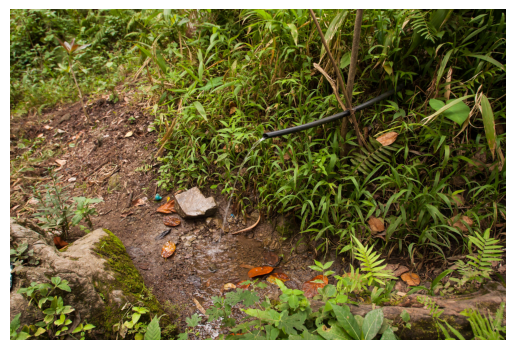

In [ ]:
# Displaying the first image
sample_image = real_images_sample["real_image"][0]

plt.imshow(sample_image)
plt.axis("off")  # For better visualization
plt.show()

As we can see, the first image is too high-quality for us to work with based on the available resources. Looking at the [dataset's page](https://huggingface.co/datasets/bitmind/bm-real) on HuggingFace, the histogram of the width of the images has a tail reaching almost 10,000 pixels, which is absurdly large. Our task is to rescale the images to a format with which it would be relatively uncomplicated to work. I think ```(224, 224)``` offers a reasonable balance between computational efficiency and the ability to preserve essential features of the images. Resizing them to this size ensures that the models used can process the images quickly while retaining enough detail for accurate analysis.

In [ ]:
resize_dim = (224, 224)
rescaled_images = [np.array(img.resize(resize_dim)) for img in real_images_sample["real_image"]]

We can now delete ```real_images_sample``` to free up some needed memory.

In [ ]:
del real_images_sample

Also, we should save ```rescaled_images``` onto the disk memory.

In [ ]:
np.savez("rescaled_images_1000.npz", *rescaled_images)

### Project Checkpoint: Rescaled Images

After having completed the data loading and rescaling, we can 'announce' what we will call throughout the notebook *Project Checkpoint*. If we delete the runtime, we can come back and continue from a certain checkpoint by importing/installing the needed packages (some located at the start of the notebook) and loading the necessary files. Feel free to adjust the code to load files from your personal Google Drive.

In [ ]:
loaded_rescaled_images = np.load("rescaled_images_1000.npz")
rescaled_images = [loaded_rescaled_images[key] for key in loaded_rescaled_images] # Turning to a list

## 4. Image Captioning

Our next task is to generate captions for each image. Later in the notebook, we will use these captions to generate artificial images.

For this purpose, we are going to use BLIP (Bootstrapped Language-Image Pretraining). It is from [HuggingFace](https://huggingface.co/Salesforce/blip-image-captioning-base). Let's explain how BLIP works:

BLIP is a vision-language model developed by Salesforce Research. It is designed for tasks such as image captioning, visual question answering (VQA), and image-text retrieval. The model is built on a transformer architecture and consists of a vision encoder (a pre-trained Vision Transformer (ViT)), which extracts image features, and a text decoder, which generates textual descriptions based on those features. One of BLIP’s key strengths is its bootstrapped pretraining approach. The process works in two main stages. First, the model learns from noisy image-text pairs found in large-scale web datasets. Since these pairs may not always be accurate, BLIP applies self-supervised objectives like contrastive learning and masked language modelling to refine the text-image alignment. Then, the model undergoes supervised learning on high-quality datasets, where human-annotated image-text pairs ensure that it generates more reliable and meaningful captions. Here is an image showing its architecture:

<img src="https://production-media.paperswithcode.com/methods/bf9bd9a4-da80-4059-bdc1-3f49549d4044.png" width=700/>

More information about BLIP and the other used models is provided in their official scientific articles, which will be linked in the References section at the end of the notebook. We are going to use the version of BLIP designed for image captioning.

BLIP is an excellent fit for our FADE PoC project as it produces semantically meaningful and contextually rich captions, ensuring the generated images will be closely aligned with real ones later. This improves the quality of the contrastive learning process when distinguishing between authentic and synthetic images. Secondly, BLIP is pretrained on diverse web data, making it robust to variations in image content such as the one in our dataset.

In [ ]:
from transformers import BlipProcessor, BlipForConditionalGeneration

captioner_processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
captioner = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/287 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/506 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/711k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/125 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/990M [00:00<?, ?B/s]

I am sure it is obvious but let's still mention it. Each transformer model comes with a corresponding preprocessor because different models have unique input requirements. These preprocessors ensure that raw data is transformed into the expected format for optimal performance.

Let's continue.

In [ ]:
from PIL import Image

In [ ]:
def generate_captions_batch(image_batch):
    """
    Generates captions for a batch of images using the BLIP image captioning model.

    Args:
        image_batch (list of np.ndarray): A list of images represented as NumPy arrays (H, W, C).

    Returns:
        list of str: The generated captions for each image in the batch.
    """
    images = [Image.fromarray(img) for img in image_batch]
    inputs = captioner_processor(images=images, return_tensors="pt", padding=True).to(captioner.device)

    out = captioner.generate(**inputs)

    # Decode captions
    captions = [captioner_processor.decode(o, skip_special_tokens=True) for o in out]

    return captions

In [ ]:
def process_images(images, batch_size=8):
    """
    Processes a list of images in batches and generates captions sequentially.

    Args:
        images (list of np.ndarray): A list of images represented as NumPy arrays (H, W, C).
        batch_size (int, optional): The number of images to process per batch. Defaults to 8.

    Returns:
        list of str: A list of captions corresponding to each input image.
    """
    captions = []

    for i in range(0, len(images), batch_size):
        batch = images[i : i + batch_size]  # Get batch of images
        batch_captions = generate_captions_batch(batch)  # Generate captions
        captions.extend(batch_captions)  # Store results

        print(f"Captioned {min(i + batch_size, len(images))}/{len(images)} images")

    return captions

In [ ]:
captions = process_images(rescaled_images)

Captioned 8/1000 images
Captioned 16/1000 images
Captioned 24/1000 images
Captioned 32/1000 images
Captioned 40/1000 images
Captioned 48/1000 images
Captioned 56/1000 images
Captioned 64/1000 images
Captioned 72/1000 images
Captioned 80/1000 images
Captioned 88/1000 images
Captioned 96/1000 images
Captioned 104/1000 images
Captioned 112/1000 images
Captioned 120/1000 images
Captioned 128/1000 images
Captioned 136/1000 images
Captioned 144/1000 images
Captioned 152/1000 images
Captioned 160/1000 images
Captioned 168/1000 images
Captioned 176/1000 images
Captioned 184/1000 images
Captioned 192/1000 images
Captioned 200/1000 images
Captioned 208/1000 images
Captioned 216/1000 images
Captioned 224/1000 images
Captioned 232/1000 images
Captioned 240/1000 images
Captioned 248/1000 images
Captioned 256/1000 images
Captioned 264/1000 images
Captioned 272/1000 images
Captioned 280/1000 images
Captioned 288/1000 images
Captioned 296/1000 images
Captioned 304/1000 images
Captioned 312/1000 images

There are some grayscale images, which should be extented to 3 dimensions. We apply this transformation now and not sooner as the captioner does not accept images with shape of (224, 224, 1).

In [ ]:
rescaled_images = [img if img.ndim == 3 else np.expand_dims(img, axis=-1) for img in rescaled_images]

It would be good to show an example of the caption quality.

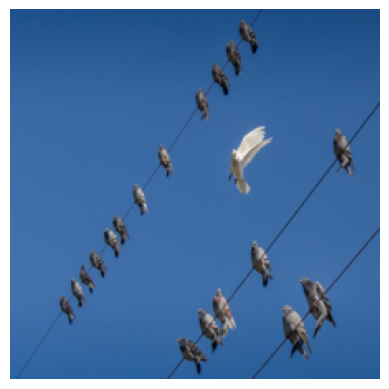

a flock of pigeons on a wire


In [ ]:
plt.imshow(rescaled_images[1])
plt.axis("off")
plt.show()
print(captions[1])

Let's include the resclaed images and captions into a dataset:

In [ ]:
from datasets import Dataset

images_with_captions = Dataset.from_dict({
    "real_image": rescaled_images,
    "caption": captions
})

In [ ]:
images_with_captions.save_to_disk("images_with_captions_1000")

Saving the dataset (0/1 shards):   0%|          | 0/1000 [00:00<?, ? examples/s]

### Project Checkpoint: Images with Captions

In [ ]:
from datasets import load_from_disk

images_with_captions = load_from_disk("/content/images_with_captions_1000/")

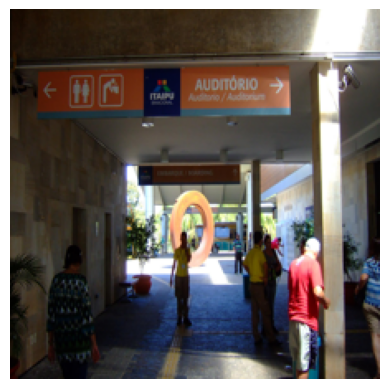

a group of people walking down a long hallway


In [ ]:
# Another example of the captions quality

plt.imshow(images_with_captions[417]["real_image"])
plt.axis("off")
plt.show()
print(images_with_captions[417]["caption"])

Objectively, I would not have managed to give a more precise description of this completely random at-first-sight image. In my opinion, as expected, these captions will do the job for us.

## 5. Image Generation from Captions

The next main step of evaluating FADE is to generate (the fake) images. We need a model which is relatively lightweight but quality at the same time. Preferably, it should be a model from the list in subsection 2.3 Rich and Poor Texture Contrast. This way, we already have benchmarks on which to evaluate our method.

Looking at the models in the table in 2.3, the selection of Stable Diffusion (SD) v1.5 for our case seems rational as it balances generation quality and computational efficiency. Compared to larger models like Midjourney and DALLE2, it requires fewer resources while still producing high-quality images. Additionally, its widespread availability and strong community support (3,875,912 downloads from HuggingFace in January 2025) make it a practical choice for reproducibility.

The model is going to be loaded from [HuggingFace](https://huggingface.co/stable-diffusion-v1-5/stable-diffusion-v1-5). It has around 1 billion parameters, which may be challenging to work with but, for sure, manageable. Stable Diffusion v1.5 generates images from text prompts by gradually denoising a latent representation. It operates in three main steps: encoding the input text into a latent space using a CLIP-based text encoder, generating a noisy latent image and refining it step by step through a U-Net model conditioned on the text, and decoding the final latent representation back into an image using a variational autoencoder (VAE) decoder. This approach makes the model efficient, as computations occur in a lower-dimensional latent space rather than directly on high-resolution images. For more information about SD, please refer to the article about Stable Diffusion linked in the References section. This is a simple representation of the process of SD:

<img src="https://www.researchgate.net/publication/383326974/figure/fig2/AS:11431281288567541@1730792701432/An-illustration-of-stable-diffusion-working-with-an-example.jpg" width="700"/>

Here is the accuracy on images generated by SD v1.5 of models mentioned by Nan Zhong et al. (2023):

|  Generator | CNNSpot | FreDect | Fusing | GramNet |  LNP  | LGrad | DIRE-G | DIRE-D | UnivFD | Their  |
|:----------:|:-------:|:-------:|:------:|:-------:|:-----:|:-----:|:------:|:------:|:------:|:------:|
|   SDv1.5   |  50.53  |  39.21  |  51.40 |  52.16  | 85.67 | 63.67 |  49.83 |  91.63 |  63.49 |  95.30 |

We are going to hopefully beat the accuracy of these models using FADE even with lower image resolution (224, 224). Having lower-resolution images and achieving higher accuracy than the models using higher-resolution images (512, 512) suggests that FADE is not only more efficient (in terms of computational resources) but also performs better in distinguishing real from generated images. Additionally, this indicates our model is more robust or better at extracting the necessary features from the lower-resolution images.

The process of generating images from each of the 1,000 is likely to take around 133 minutes using Google Colab's T4 GPU.

In [ ]:
from diffusers import StableDiffusionPipeline

model_id = "sd-legacy/stable-diffusion-v1-5"
generator_pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16)

generator_pipe.to(device)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

safety_checker/config.json:   0%|          | 0.00/4.72k [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

StableDiffusionPipeline {
  "_class_name": "StableDiffusionPipeline",
  "_diffusers_version": "0.32.2",
  "_name_or_path": "sd-legacy/stable-diffusion-v1-5",
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "image_encoder": [
    null,
    null
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    "stable_diffusion",
    "StableDiffusionSafetyChecker"
  ],
  "scheduler": [
    "diffusers",
    "PNDMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

As stated, we are going to resize the generated images to the same dimensions as the real images ((224, 224)).

In [ ]:
def resize_generated_image(generated_image, resize_dim = (224, 224)):
    """
    Resize a generated image to the specified dimensions.

    Args:
        generated_image (PIL.Image.Image): The image generated by the diffusion model.
        resize_dim (tuple, optional): The target dimensions (width, height). Default is (224, 224).

    Returns:
        np.ndarray: The resized image as a NumPy array.
    """
    resized_image = generated_image.resize(resize_dim)
    return np.array(resized_image)

In [ ]:
def get_image_by_prompt(prompt):
    """
    Generate an image from a text prompt using the Stable Diffusion model.

    Args:
        prompt (str): The text prompt describing the desired image.

    Returns:
        np.ndarray: The generated and resized image as a NumPy array.
    """
    image = generator_pipe(prompt=prompt).images[0]
    image = resize_generated_image(image)
    return image

  0%|          | 0/50 [00:00<?, ?it/s]

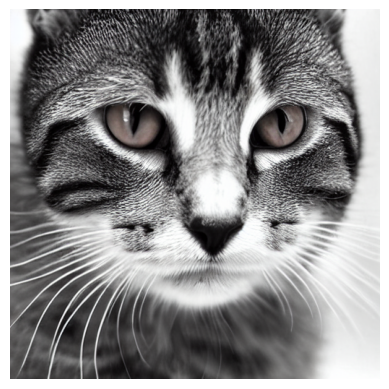

In [ ]:
# Testing the Generator Pipe first

test_prompt = generator_pipe(prompt="a cat").images[0]

plt.imshow(np.array(test_prompt))
plt.axis("off")
plt.show()

In [ ]:
# Estimated runtime on T4 GPU (by Google Colab): 133 minutes

images_with_captions = images_with_captions.map(
    lambda image: {"generated_image": get_image_by_prompt(image["caption"])}
)

Map:   0%|          | 0/1000 [00:00<?, ? examples/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

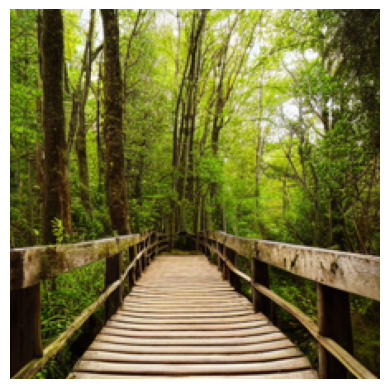

In [ ]:
# Another example of the quality of the generated images

plt.imshow(images_with_captions[87]["generated_image"])
plt.axis("off")
plt.show()

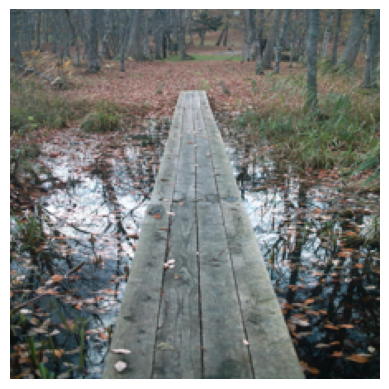

In [ ]:
# The actual image

plt.imshow(images_with_captions[87]["real_image"])
plt.axis("off")
plt.show()

Below is the dataset (```real_vs_generated```) we are going to perform the essential contrastive learning part of FADE on:

In [ ]:
real_vs_generated = images_with_captions.select_columns(["real_image", "generated_image"])

In [ ]:
real_vs_generated.save_to_disk("real_vs_generated_1000")

Saving the dataset (0/2 shards):   0%|          | 0/1000 [00:00<?, ? examples/s]

Since there might be randomness in the generation of images, the original dataset on which the experiments were conducted is provided at the link to a Google Drive folder given at the top of the notebook.

Each other part of the notebook is tied with a random seed and the exceptions are explicitly mentioned.

### Project Checkpoint: Real vs. Generated

In [ ]:
from datasets import load_from_disk

real_vs_generated = load_from_disk("real_vs_generated_1000")

As mentioned earlier in the notebook, there are grayscale images and we should deal with them before passing them into an embedding model. Sticking with the simplest solution will give us the desired results: repeating (copying) the grayscale dimension into the three other channels (RGB) using mapping (applying a function to each sample).

In [ ]:
real_vs_generated = real_vs_generated.map(lambda image: {
    "real_image": np.array(image["real_image"]).repeat(3, axis=-1)
    if np.array(image["real_image"]).shape[2] == 1 else np.array(image["real_image"]),

    "generated_image": np.array(image["generated_image"]).repeat(3, axis=-1)
    if np.array(image["generated_image"]).shape[2] == 1 else np.array(image["generated_image"])
})

Map:   0%|          | 0/1000 [00:00<?, ? examples/s]

In [ ]:
# A check
# [91] was a grayscale image before the transformations

np.array(real_vs_generated[91]["real_image"]).shape

(224, 224, 3)

Even after the mapping, the images remain of type ```list```. We are going to use ```with_transform``` (unlike ```map```, it does not modify the dataset itself but applies transformations on retrieval) to turn into NumPy arrays. It is ideal for dynamic transformations and ```map``` is best for one-time transformations.

In [ ]:
real_vs_generated = real_vs_generated.with_transform(lambda image: {
    "real_image": np.array(image["real_image"]),
    "generated_image": np.array(image["generated_image"])
})

In [ ]:
# A check

type(real_vs_generated[91]["real_image"])

numpy.ndarray

## 6. Contrastive Learning for Fine-Tuning

The next part is unarguably the most important, the most complex, and the most unique part of the process of FADE. We are going to thoroughly explain each step of the process of fine-tuning a transformer using contrastive learning between real and generated images.

Firstly, let's integrate TensorBoard logging. TensorBoard is a visualization tool for monitoring and analyzing deep learning experiments. It helps us track metrics like loss and accuracy, visualize model graphs, inspect weights and biases, and compare multiple training runs. By integrating it into our training process, we can gain insights into model performance, detect issues early, and make informed adjustments.

In [ ]:
from torch.utils.tensorboard import SummaryWriter

writer = SummaryWriter(log_dir="runs/fine_tuning_embedder")

Now, let's prepare the data for fine-tuning (taking a pretrained model and training it further on a specific dataset to adapt it to a new task while preserving its learned features).

### 6.1 Data Preparation

We are going to split the data into training, validation, and test sets. I think that a split of 80/10/10 would be reasonable. Since we do not have much data (1,000 real and 1,000 generated images) we should keep a relatively big ratio of the data for validation and testing. Using more images for these two sets would limit our training set, which is not desirable. We are going to use the built-in method for ```datasets.Dataset```.

The ```.values()``` method is used here because the ```train_test_split``` method returns a dictionary-like object containing the split datasets, and ```.values()``` extracts the values (i.e., the actual split datasets) from it.

In [ ]:
real_vs_generated_train, real_vs_generated_test = real_vs_generated.train_test_split(test_size=0.2, shuffle=True, seed=17).values()
real_vs_generated_val, real_vs_generated_test = real_vs_generated_test.train_test_split(test_size=0.5, shuffle=True, seed=17).values()

In PyTorch, the ```DataLoader``` is used to efficiently load and manage datasets during training. It simplifies the process of batching data, shuffling it, and loading it in parallel using multiple workers, which helps speed up training. By handling the batching, it ensures that data is loaded in a way that fits into memory. Essentially, the ```DataLoader``` abstracts and automates the tedious tasks related to data processing, making it easier to focus on model development.

Using `batch_size=8` when fine-tuning the embedder is a rational trade-off between GPU memory constraints and gradient estimation stability. Swin Transformers are memory-intensive, so a larger batch size could lead to out-of-memory errors, whereas a batch size of 8 ensures that training fits within GPU limits. This batch size is also sufficient to provide stable gradient estimates, which is important for our contrastive learning task. Having multiple samples per batch allows for more meaningful similarity comparisons. Additionally, a batch size of 8 enables more frequent weight updates, which can help in scenarios where the dataset is diverse (exactly our case) and the model benefits from more frequent feedback. Since contrastive loss depends on comparing multiple embeddings within a batch, having at least a few samples ensures that meaningful pairs can be formed. To sum up, ```batch_size=8``` is a practical choice to balance performance and resource constraints.

As with most hyperparameters, we do not know whether our theory is correct until we experiment. If needed, we are going to tune specific hyperparameters.

In [ ]:
from torch.utils.data import DataLoader

train_loader = DataLoader(real_vs_generated_train, batch_size=8, shuffle=True)
val_loader = DataLoader(real_vs_generated_val, batch_size=8, shuffle=True)
test_loader = DataLoader(real_vs_generated_test, batch_size=8, shuffle=True)

### 6.2 Defining Contrastive Loss Function

It is quite obvious that contrastive learning requires defining a contrastive loss function. We are going the use **Cosine Similarity**.

Cosine similarity is arguably the best choice for contrastive learning in FADE as it measures the angular distance between two vectors, focusing on their orientation rather than their magnitude. This makes it ideal for tasks where the direction of the embeddings is more important than their scale. In our context of fake image detection, cosine similarity helps the embedder model learn to point the vectors (the embeddings) of real and fake images in different directions. This approach ensures the model becomes more sensitive to the inherent features of images, like textures or patterns, rather than being influenced by irrelevant factors such as image brightness or size. Since contrastive learning in FADE relies on creating clear boundaries between real and generated images, cosine similarity is likely the most sensible decision for pushing the embeddings to exhibit this kind of meaningful separation. We are going to try and minimize it (not completely (we will explain soon why)).

The cosine similarity between two vectors is defined as:

$$
\begin{aligned}
& \cos (\theta)=\frac{\mathbf{A} \cdot \mathbf{B}}{\|\mathbf{A}\|\|\mathbf{B}\|}=\frac{\sum_{i=1}^n A_i B_i}{\sqrt{\sum_{i=1}^n A_i^2} \sqrt{\sum_{i=1}^n B_i^2}}; \\
\end{aligned}
$$

where $A$ and $B$ are the two vectors; $\|\mathbf{A}\|$ and $\|\mathbf{B}\|$ – their corresponding lengths; and $A_i$ and $B_i$ – their dimensions.

The formula is derived from the formula of the dot product between two vectors:

$$
\begin{aligned}
& \cos (\theta) \|\mathbf{A}\|\|\mathbf{B}\|= \mathbf{A} \cdot \mathbf{B} = \sum_{i=1}^n A_i B_i;
\end{aligned}
$$

We have to modify it a little bit as $\cos  (\theta) \in [-1; 1]$. $-1$ is for vectors pointing in opposite directions and $1$ – vectors pointing to the same direction. To keep the loss non-negative, we are going to add $+1$.

By adding 1, we shift the range of the loss function from 0 to 2. This transformation is useful as it makes the loss function easier to work with. Alternatively, negative values would complicate the loss and gradient calculation.

Finally, this is the formula we are going to use:

$$
\text{Loss}(A, B) = \cos (\theta) + 1 = \frac{\mathbf{A} \cdot \mathbf{B}}{\|\mathbf{A}\|\|\mathbf{B}\|} + 1;
$$
$$
\text{Loss}(A, B) \in [0, 2];
$$

In [ ]:
import torch.nn as nn

# Contrastive Loss based on Cosine Similarity
class ContrastiveLoss(nn.Module):
    def __init__(self):
        super(ContrastiveLoss, self).__init__()

    def forward(self, output1, output2):
        cosine_similarity = nn.functional.cosine_similarity(output1, output2)
        loss = cosine_similarity + 1

        return loss.mean()

In [ ]:
loss_fn = ContrastiveLoss()

### 6.3 Choosing an Embedding Model

This is the part where we choose an embedding model to fine-tune for FADE. As in the previous steps, it would be rational to choose something reliable and computationally efficient at the same time. The tiny version of Swin would be a great choice (taken from [HuggingFace](https://huggingface.co/microsoft/swin-tiny-patch4-window7-224)) as it has a total of 28.3M params, which is relatively little. Nevertheless, Swin models are powerful and dependable. Let's explain how it works in a bit more detail.

The Swin Transformer is a type of vision transformer (ViT). Unlike most transformers, which process the entire image at once, Swin Transformer divides the image into non-overlapping windows. These windows allow the model to focus on local features, making it computationally more feasible for high-resolution images. The key idea behind Swin Transformer is the use of a hierarchical structure, where each stage of the model progressively merges smaller windows into larger ones, allowing the model to capture both local and global context.

<img src="https://av-eks-lekhak.s3.amazonaws.com/media/__sized__/article_images/swin_transformer_architecture-thumbnail_webp-600x300.webp" width="500"/>

At its core, the Swin Transformer uses shifted windows. In each stage, the windows are shifted relative to the previous stage, enabling better interaction between neighboring patches. This shifting mechanism helps in capturing information across the image more effectively. The model utilizes multi-head self-attention within these windows, which is then aggregated across layers to capture different levels of spatial information.


The hierarchical design is achieved by progressively decreasing the resolution of the image patches, leading to a more compact representation. This allows the Swin Transformer to scale well to large images while maintaining a manageable computational load. By combining local and global information through its window-based attention mechanism, the Swin Transformer achieves impressive performance on a variety of vision tasks, such as image classification, object detection, and semantic segmentation. As expected, we are going to use it for an embedding task. Here is an illustration of the architecture of Swin.

<img src="https://i.ytimg.com/vi/z_8lajPxGQo/maxresdefault.jpg?sqp=-oaymwEmCIAKENAF8quKqQMa8AEB-AH-CYAC0AWKAgwIABABGEogWShlMA8=&rs=AOn4CLBQ_T22PCgPGF-THxppfj65Vjp25Q" width="700"/>

The Swin Transformer (the tiny version) is well-suited for the task of fine-tuning an embedder model in FADE because of its ability to efficiently capture both local and global features of images through its hierarchical design. Since fine-tuning an embedder involves learning rich, transferable features that can distinguish between real and generated images, the Swin Transformer's use of shifted windows helps maintain spatial coherence while enabling interaction between distant parts of an image. Its multi-level feature extraction ensures that the embedder can learn embeddings that are both detailed and abstract, which aids in distinguishing fine-grained differences between authentic and generated images. The Swin Transformer’s computational efficiency (just under 30M parameters) and its ability to handle fine details across multiple layers make it the perfect choice for this kind of fine-tuning task.

In [ ]:
from transformers import AutoImageProcessor, SwinModel

embedder_image_processor = AutoImageProcessor.from_pretrained("microsoft/swin-tiny-patch4-window7-224")
embedder = SwinModel.from_pretrained("microsoft/swin-tiny-patch4-window7-224")

embedder.to(device)

preprocessor_config.json:   0%|          | 0.00/255 [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.48, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


config.json:   0%|          | 0.00/71.8k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/113M [00:00<?, ?B/s]

SwinModel(
  (embeddings): SwinEmbeddings(
    (patch_embeddings): SwinPatchEmbeddings(
      (projection): Conv2d(3, 96, kernel_size=(4, 4), stride=(4, 4))
    )
    (norm): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
    (dropout): Dropout(p=0.0, inplace=False)
  )
  (encoder): SwinEncoder(
    (layers): ModuleList(
      (0): SwinStage(
        (blocks): ModuleList(
          (0): SwinLayer(
            (layernorm_before): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
            (attention): SwinAttention(
              (self): SwinSelfAttention(
                (query): Linear(in_features=96, out_features=96, bias=True)
                (key): Linear(in_features=96, out_features=96, bias=True)
                (value): Linear(in_features=96, out_features=96, bias=True)
                (dropout): Dropout(p=0.0, inplace=False)
              )
              (output): SwinSelfOutput(
                (dense): Linear(in_features=96, out_features=96, bias=True)
            

For optimizing the loss function, we are going to use ```Adam``` optimizer.

Adam (short for Adaptive Moment Estimation) is considered a great optimizer (not just for our project) because it combines the benefits of two other popular optimizers: AdaGrad and RMSProp. It adapts the learning rate for each parameter based on its first and second moments, which helps it maintain a stable and efficient learning process. The first moment refers to the mean of the gradients, while the second moment refers to the uncentered variance of the gradients (the spread of the gradient values over time). By using these moments, Adam adjusts the learning rate individually for each parameter, allowing it to converge faster and handle sparse gradients better. Furthermore, Adam is computationally efficient, has low memory requirements, and is relatively simple to implement. It also often performs well in practice across different types of networks and datasets, especially when there is noise in the gradients. The official scientific article presenting Adam is stated in the References section.

We need a low learning rate (such as 0.00001) as our embedder model is already fitted to create *meaningful* embeddings and we do not want to ruin the *meanings* of these embeddings. That is why for this part of the project we do **not aim to reach full convergence of the model**. We will initially experiment with an embedder with just a small amount of fine-tuning. Otherwise, the task would translate to a classification not using FADE as during convergence, the angles between each pair of a real and a fake image will be 180° ($\text{cos}(180°) = -1$), which is a simpler than FADE version of binary classification not using meaningful embeddings.

In [ ]:
from torch.optim import Adam

optimizer = Adam(embedder.parameters(), lr=1e-5)

### 6.4 Fine-Tuning Swin

Fine-tuning Swin will probably be the most decisive part of the project. Nonetheless, since our goal is not to reach full convergence, we will experiment with a certain model state. If the final results are not satisfactory, we will return and perform hyperparameter tuning.

As mentioned multiple times, we should not over-fine-tune the model. This is not only to prevent overfitting but also to preserve the meanings of the embedding. We **should** not reach the state where the real images have the exact same embedding and the generated as well.

We will start training only for five epochs (an epoch is one complete pass through the entire training dataset), and I expect the model to learn quickly. We should monitor the contrastive loss during training. If the loss approaches zero too fast, it might indicate that Swin is collapsing the embeddings too aggressively.

In [ ]:
num_epochs = 5

The next is to define the training loop. Each epoch starts with putting the model into training mode. This is important because these layers function differently during inference, and keeping the model in the correct mode helps it learn properly. We will store the current contrastive loss function in ```running_train_loss```. Iterating over each batch, we are going to separate the real and generated pairs. Preprocessing them using the embedder's processor and passing them into the model imitates the process in *Siamese Neural Networks*\*.

\*Siamese neural networks (SNNs) are a type of neural network architecture designed for comparing two inputs. They consist of two identical subnetworks (sharing weights) that process each input separately and then compute a similarity score between their outputs. The key difference between SNNs and our embedder is that we use binary contrastive loss instead of triplet loss. In short, triplet loss is a loss function used in tasks where the goal is to learn an embedding space that places similar items closer together and dissimilar items farther apart. It operates on triplets of inputs: an anchor, a positive (similar to the anchor), and a negative (dissimilar to the anchor).

In the code, you can spot the use of the method ```.last_hidden_state.mean(dim=1)```. It is used to obtain a fixed-size vector representation (the embedding) of each image. The ```embedder``` produces embeddings for each token in the image, representing patches or regions of the image. The ```last_hidden_state``` contains the final output for each token after the model processes the image. Since the output is a sequence of vectors (one per token), ```mean(dim=1)``` calculates the average of these embeddings across all the tokens. This results in the summarization of the entire image into a single embedding vector. This vector then serves as the feature representation of the image. This is also called mean pooling.

Anyway, after getting the embeddings of the images we calculate our custom loss function and perform backpropagation computing the parameters' gradients. We use the optimizer to take a learning step. Then we store the average loss function value.

It would be good to also evaluate the model using the validation set. We repeat the same steps as during the training set loop with the exception that our model is in evaluation mode, that we do not calculate gradients, and that we do not take the optimization step. Finally, we print the results of each epoch, while also logging them into TensorBoard.

Additionally, we do not need to save the best model as we do not necessarily need the model with the lowest value of the loss function.

We will perform techniques such as Dropout and smaller learning rate if the model overfits.

In [ ]:
for epoch in range(num_epochs):
    # Training step
    embedder.train()
    running_train_loss = 0.0

    for batch in train_loader:
        real_images = batch["real_image"]
        generated_images = batch["generated_image"]

        inputs_real = embedder_image_processor(real_images, return_tensors="pt").to(device)
        inputs_gen = embedder_image_processor(generated_images, return_tensors="pt").to(device)

        outputs_real = embedder(**inputs_real)
        outputs_gen = embedder(**inputs_gen)

        embeddings_real = outputs_real.last_hidden_state.mean(dim=1)
        embeddings_gen = outputs_gen.last_hidden_state.mean(dim=1)

        loss = loss_fn(embeddings_real, embeddings_gen)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        running_train_loss += loss.item()

    avg_train_loss = running_train_loss / len(train_loader)

    # Validation step
    embedder.eval()
    running_val_loss = 0.0

    # No need to compute gradients
    with torch.no_grad():
        for batch in val_loader:
            real_images = batch["real_image"]
            generated_images = batch["generated_image"]

            inputs_real = embedder_image_processor(real_images, return_tensors="pt").to(device)
            inputs_gen = embedder_image_processor(generated_images, return_tensors="pt").to(device)

            outputs_real = embedder(**inputs_real)
            outputs_gen = embedder(**inputs_gen)

            embeddings_real = outputs_real.last_hidden_state.mean(dim=1)
            embeddings_gen = outputs_gen.last_hidden_state.mean(dim=1)

            val_loss = loss_fn(embeddings_real, embeddings_gen)
            running_val_loss += val_loss.item()

    avg_val_loss = running_val_loss / len(val_loader)

    print(f"Epoch {epoch + 1}/{num_epochs}")
    print(f"Training Loss: {avg_train_loss:.4f}")
    print(f"Validation Loss: {avg_val_loss:.4f}\n")

    writer.add_scalar("Loss/train", avg_train_loss, epoch)
    writer.add_scalar("Loss/val", avg_val_loss, epoch)

It looks like you are trying to rescale already rescaled images. If the input images have pixel values between 0 and 1, set `do_rescale=False` to avoid rescaling them again.


Epoch 1/5
Training Loss: 1.2084
Validation Loss: 1.1264

Epoch 2/5
Training Loss: 1.0480
Validation Loss: 1.0253

Epoch 3/5
Training Loss: 0.8843
Validation Loss: 0.7775

Epoch 4/5
Training Loss: 0.5036
Validation Loss: 0.3702

Epoch 5/5
Training Loss: 0.2280
Validation Loss: 0.2076



Alright, I do not think we should train the embedder any further. It already returns distinguished embeddings of the real and the fake images. The loss function is low for both the training and the validation sets, so the model has not overfitted the training set.

During training, the validation loss seemed to be lower than the training. This was unexpected and in some cases indicates data leakage. Fortunately, after double-checking the code I assume that data leakage did not happen. There are a few other potential explanations. One possibility is that the validation set could be simpler than the training set. If the validation set consists of easier examples, our model may perform better on it, resulting in a lower validation loss. On the other hand, the training set might contain more challenging or noisy examples, which leads to a higher loss during training. The model's training process itself might also explain the difference in losses. During training, the model is adjusting its weights, and gradients can fluctuate, which can introduce noise into the training loss. However, the validation loss is calculated on a fixed set of data that doesn't influence the model's parameters, potentially leading to smoother and lower loss values. In general, this scenario is not a major concern as long as the embedder is generalizing well to new data.

For this task, let's continue with evaluating the embedder on the testing set (similar process to the validation set evaluation in the training process). If the loss is as low as the training and validation ones, I think we can confidently proceed to the next step.

There is no real need to print and log into TensorBoard the average cosine similarity, but this way, we can test whether the loss function is working as expected.

In [ ]:
# Putting the model in evaluation mode
embedder.eval()

total_loss = 0.0
total_samples = 0

cosine_similarities = []

# No need to compute gradients
with torch.no_grad():
    for batch in test_loader:
        real_images = batch["real_image"]
        generated_images = batch["generated_image"]

        inputs_real = embedder_image_processor(real_images, return_tensors="pt").to(device)
        inputs_gen = embedder_image_processor(generated_images, return_tensors="pt").to(device)

        outputs_real = embedder(**inputs_real)
        outputs_gen = embedder(**inputs_gen)

        embeddings_real = outputs_real.last_hidden_state.mean(dim=1)
        embeddings_gen = outputs_gen.last_hidden_state.mean(dim=1)

        # We can try another approach for storing the total loss
        # This way we perform another check on the code quality
        # The results are expected to be the same

        loss = loss_fn(embeddings_real, embeddings_gen)
        total_loss += loss.item() * real_images.size(0) # Since loss is returning scalar values
        total_samples += real_images.size(0)

        # Calculating cosine similarities
        cosine_sim = torch.nn.functional.cosine_similarity(embeddings_real, embeddings_gen)
        cosine_similarities.extend(cosine_sim.cpu().numpy())

avg_loss = total_loss / total_samples
print(f"Test Loss: {avg_loss:.4f}")

avg_cosine_similarity = sum(cosine_similarities) / len(cosine_similarities)
print(f"Average Cosine Similarity on Testing Set: {avg_cosine_similarity:.4f}")

writer.add_scalar("Loss/test", avg_loss)
writer.add_scalar("CosineSimilarity/test", avg_cosine_similarity)
writer.close()

Test Loss: 0.3565
Average Cosine Similarity on Testing Set: -0.6435


As we can witness, the test loss is almost as low as the training and validation ones. This unequivocally indicates the model has learned the distributions of the real images and their corresponding ones created by the generator. In other words, it learnt to distinguish them.

Let's proceed with saving the model's fine-tuned state. ```.pth``` files are used in PyTorch to save model weights, checkpoints, or entire models. They contain serialized data in the form of a dictionary, which includes the learned parameters of a neural network. These files can be loaded later to make predictions without needing to retrain from scratch.

In [ ]:
torch.save(embedder.state_dict(), "embedder.pth")

We can open TensorBoard using the following commands (for loading TensorBoard and opening it respectively):

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

### Project Checkpoint: Embedder

In [ ]:
from transformers import AutoImageProcessor, SwinModel

embedder_image_processor = AutoImageProcessor.from_pretrained("microsoft/swin-tiny-patch4-window7-224")
embedder = SwinModel.from_pretrained("microsoft/swin-tiny-patch4-window7-224")

# Load the fine-tuned weights
embedder.load_state_dict(torch.load("embedder.pth"))
embedder.to(device)

<ipython-input-10-57ec5b02a094>:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  embedder.load_state_dict(torch.load("embedder.pth"))


SwinModel(
  (embeddings): SwinEmbeddings(
    (patch_embeddings): SwinPatchEmbeddings(
      (projection): Conv2d(3, 96, kernel_size=(4, 4), stride=(4, 4))
    )
    (norm): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
    (dropout): Dropout(p=0.0, inplace=False)
  )
  (encoder): SwinEncoder(
    (layers): ModuleList(
      (0): SwinStage(
        (blocks): ModuleList(
          (0): SwinLayer(
            (layernorm_before): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
            (attention): SwinAttention(
              (self): SwinSelfAttention(
                (query): Linear(in_features=96, out_features=96, bias=True)
                (key): Linear(in_features=96, out_features=96, bias=True)
                (value): Linear(in_features=96, out_features=96, bias=True)
                (dropout): Dropout(p=0.0, inplace=False)
              )
              (output): SwinSelfOutput(
                (dense): Linear(in_features=96, out_features=96, bias=True)
            

### 6.5 Preparation of Dataset for Classification

Going forward, we should structure the data in a format which will be suitable for the classification. The new ```datasets.Dataset``` called ```images_classification``` will contain two columns: ```image```, where the real and the fake images are stored; and ```is_real```, containing integer values of 1 or 0 for real and fake images respectively. It will have 2,000 rows in total (1,000 for each class). Please run 'Project Checkpoint: Real vs. Generated' and the initial cells at the top of the notebook before creating the dataset.

In [ ]:
# Separating the real and the fake images and adding "is_real"
real_images = real_vs_generated.select_columns(["real_image"]).add_column("is_real", [1] * len(real_vs_generated))
generated_images = real_vs_generated.select_columns(["generated_image"]).add_column("is_real", [0] * len(real_vs_generated))

In [ ]:
real_images = real_images.rename_column("real_image", "image")
generated_images = generated_images.rename_column("generated_image", "image")

In [ ]:
from datasets import Dataset, concatenate_datasets

images_classification = concatenate_datasets([real_images, generated_images])

Since just after Project Checkpoint: Real vs. Generated there are still grayscale images, we should apply the mapping that turns them into three channel images (RGB).

In [ ]:
images_classification = images_classification.map(lambda image: {
    "image": np.array(image["image"]).repeat(3, axis=-1)
    if np.array(image["image"]).shape[2] == 1 else np.array(image["image"]),
    "is_real": image["is_real"]
})

In [ ]:
images_classification.save_to_disk("images_classification_1000")

Saving the dataset (0/2 shards):   0%|          | 0/2000 [00:00<?, ? examples/s]

### Project Checkpoint: Images for Classification

In [ ]:
from datasets import load_from_disk

images_classification = load_from_disk("images_classification_1000")

The images from the dataset are of type list and we need to turn them into NumPy arrays.

In [ ]:
images_classification = images_classification.with_transform(lambda image: {
    "image": np.array(image["image"]),
    "is_real" : image["is_real"]
})

In [ ]:
# Ensuring everything works as expected

print(images_classification)
print(type(images_classification[0]["image"]))
print(images_classification[91]["image"].shape)

Dataset({
    features: ['image', 'is_real'],
    num_rows: 2000
})
<class 'numpy.ndarray'>
(224, 224, 3)


### 6.6 Visualization of the Embeddings

I believe the plot of the embeddings of the real and the fake images may give us another evaluation of the embedder's ability to distinguish the features of real and fake images. Also, it is expected for the plot to be elegant.

For the task of squeezing the embeddings into 2D, we are going to use a technique called t-SNE. Let's explain how it works in a bit more detail.

t-SNE (t-distributed Stochastic Neighbor Embedding) is one of the most powerful dimensionality reduction techniques, primarily used for the visualization of high-dimensional data (such as our embeddings). The technique is well-suited for data that lives in very high-dimensional spaces (often with hundreds or thousands of features). Its goal is to map this high-dimensional data into a lower-dimensional space (2D in our case) while preserving the structure and relationships within the data as much as possible.

t-SNE works by modelling the similarities between data points in the high-dimensional space using a probability distribution. Specifically, it uses a Gaussian distribution to measure the similarity of each point to others. The similarity between two points is defined as the conditional probability that one point would choose the other as its neighbor, based on their distance. The idea is that points that are close together in the high-dimensional space should have a high probability of being neighbours, while those further apart should have a lower probability. This process captures the local structure of the data, meaning that points that are similar to each other in the original space should be close to each other in the resulting lower-dimensional projection.

Once these similarities are computed, t-SNE creates a new probability distribution in the lower-dimensional space (the final space) that represents the relationships between points in this new space. The key challenge is then to minimize the Kullback-Leibler (KL) divergence, a measure of the difference between the high-dimensional and low-dimensional probability distributions, through optimization techniques like gradient descent. The process works iteratively, adjusting the positions of the points in the lower-dimensional space until the KL divergence is minimized, which effectively means the lower-dimensional map has preserved the structure of the original high-dimensional data as accurately as possible.

The reason why t-SNE is particularly effective for visualization purposes is that it places a strong emphasis on preserving local similarities (such as the 'clusters' of the real and the fake images) while also balancing global structure. It excels at revealing groups of points (the embeddings of the images) similar to each other. This is especially useful for our task of plotting embeddings. Unlike linear methods like Principal Component Analysis (PCA), t-SNE can uncover more complex, non-linear relationships in the data, making it suitable for datasets where the relationship between features is not easily captured by linear transformations.

For our task of visualizing the embeddings of real and fake images in 2D, t-SNE seems perfect. By reducing the dimensionality of these embeddings to 2D, t-SNE can show us whether the model has learned to cluster similar images together. If the embeddings of real and fake images form well-separated clusters, it suggests that the model has learned distinct features that effectively differentiate the two categories. On the other hand, if the clusters of real and fake images overlap, it would indicate that the model is struggling to distinguish between them and that the embeddings may not capture the underlying differences well.

Another strength of t-SNE for this task is its ability to preserve the local structure of the data. This means that images that are similar to each other (whether real or fake) will remain close together in the 2D projection, allowing us to visually assess the similarity between instances within each class. For example, if fake images generated by the model are clustered together in one region, and real images are clustered in another, this provides valuable insights into how the model perceives and separates these two types of data. Additionally, t-SNE can highlight any outliers or anomalies that may exist in the dataset, revealing instances that don't fit well into either category.

However, t-SNE does have limitations. The technique is sensitive to the initial conditions and the perplexity parameter, which controls how many neighbours are considered when calculating similarities. Additionally, t-SNE doesn't necessarily preserve global relationships well; while it does a great job of maintaining local distances (neighbour relationships), it might distort the global structure, meaning the distances between clusters in the 2D visualization might not reflect their true distances in the high-dimensional space.

In summary, t-SNE is an excellent tool for visualizing embeddings in 2D. Its ability to preserve local structure while providing insights into the relationships between data points makes it ideal for assessing how well a model is distinguishing between real and fake images. The ability to visualize these embeddings in a 2D space allows for a clearer understanding of the model’s performance, revealing whether the separation between real and fake images is meaningful or if the model needs further fine-tuning.

Here is an example of a t-SNE transformation on the MNIST dataset (collection of 70,000 grayscale images of handwritten digits):

<img src="https://miro.medium.com/v2/1*njEd7PiqBW-zW38E23Ho9w.png" width="500"/>

Please run Project Checkpoint: Embedder, Project Checkpoint: Images for Classification as well as the transformation below it (turning the images into NumPy arrays), and the cells at the top of the notebook before applying these steps

In [ ]:
from torch.utils.data import DataLoader

# A dataloader for the whole dataset
# It is important to NOT shuffle the dataset!
# It begins with 1,000 real and ends with 1,000 generated images
tsne_dataloader = DataLoader(images_classification, batch_size=8, shuffle=False)

In [ ]:
from sklearn.manifold import TSNE

# Setting the embedder to evaluation mode
embedder.eval()

embeddings = []

In [ ]:
# Extracting the embeddings

with torch.no_grad():
    for batch in tsne_dataloader:
        images = batch["image"].to(device)

        inputs = embedder_image_processor(images, return_tensors="pt").to(device)
        outputs = embedder(**inputs).last_hidden_state.mean(dim=1)

        # We should have the embeddings in NumPy format instead of Tensors to prevent an error by t-SNE
        embeddings.append(outputs.cpu().numpy())

It looks like you are trying to rescale already rescaled images. If the input images have pixel values between 0 and 1, set `do_rescale=False` to avoid rescaling them again.


In [ ]:
# Convert to NumPy arrays as t-SNE works faster using them
embeddings = np.concatenate(embeddings, axis=0)

In [ ]:
embeddings.shape

(2000, 768)

As we can see, the embeddings live in a 768-dimensional space, which is a lot.

Let's revise what the parameter ```perplexity``` means in t-SNE. It controls the balance between local and global aspects of the data during the dimensionality reduction process. It is related to the number of nearest neighbours considered when calculating pairwise similarities between data points. A lower perplexity value tends to focus more on local relationships, meaning the algorithm will try to preserve small-scale structure, while a higher perplexity value gives more importance to global relationships, preserving the overall data distribution. Typically, perplexity values range from 5 to 50. We will choose 30 as it offers balance between capturing local relationships (as the dataset is diverse) and preserving the overall global structure of the data (as we want to determine whether the embeddings are 'ruined').

In [ ]:
tsne = TSNE(n_components=2, perplexity=30, random_state=17)
embeddings_2d = tsne.fit_transform(embeddings)

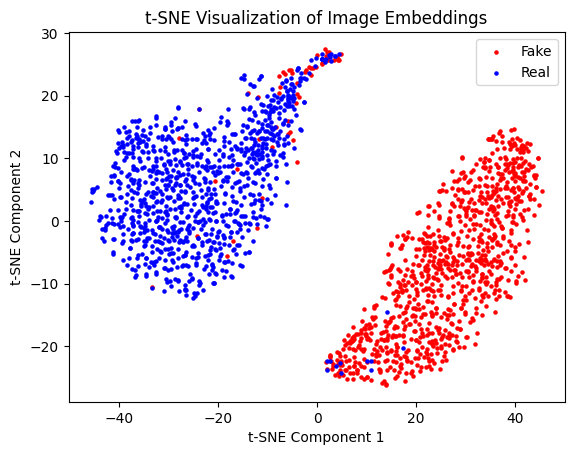

In [ ]:
# The first 1,000 images are real, while the last 1,000 – fake
plt.scatter(embeddings_2d[:1000, 0], embeddings_2d[:1000, 1], c="red", label="Fake", s=5, alpha=1)
plt.scatter(embeddings_2d[1000:, 0], embeddings_2d[1000:, 1], c="blue", label="Real", s=5, alpha=1)

plt.legend()

plt.title("t-SNE Visualization of Image Embeddings")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")

plt.show()

Judging by the plot, we can once again confirm that the model managed to discriminate the embeddings of the real and the generated images. We can visually separate two clusters with few points in the wrong one, particularly fake images overlapping the real images cluster (False Positives (FP)). This might be due to random errors. Hopefully, we will still classify them correctly using their full vector representation.

Another big positive we can take away from the plot is that there are images from the same clusters far from each other. This indicates that the model managed to preserve its ability to create meaningful embeddings for the images, which was our initial goal.

Having completed the task of fine-tuning the embedder successfully, I believe we are ready to move forward.

## 7. Real vs. Fake Image Classification

Before proceeding with the section we should define a TensorBoard writer.

In [ ]:
from torch.utils.tensorboard import SummaryWriter

writer = SummaryWriter("runs/training_classifier")

### 7.1 Training the Classifier

We have reached the final part of the PoC of FADE – creating the final classifier. As we saw from the previous section, the fine-tuned model manages to create meaningful embeddings while also dealing with the most important task of distinguishing the embeddings of real and generated images.

Additionally, looking at the t-SNE plot, the classification task is not expected to be complicated because the 'clusters' of authentic and fake images are well-defined, even in a 2-dimensional space. At first, we can experiment with adding just one additional Linear (Dense) layer. I believe just a simple layer attached as a 'head' to the frozen embedder would be enough as the embedder does most of the work. If the results are satisfactory, we will end up with a model which is relatively simple and robust at the same time.

As you may remember, our main goal is to beat the accuracy of the detection models mentioned in 2.3 when trained/tested on SD v1.5. The line of the table which is most relative to the objective is extracted in 5. **The accuracy we aim to achieve is at least 96%**, which is more than all of the models stated by Nan Zhong et al. (2023).

Please run Project Checkpoint: Embedder, Project Checkpoint: Images for Classification with the following NumPy transformation, and the cells at the top of the notebook before continuing with the final part of FADE.

Firstly, we are going to freeze the embedder (so that it does not train further). Since its preprocessor does not have trainable parameters, we do not need to freeze it.

In [ ]:
for param in embedder.parameters():
    param.requires_grad = False

Secondly, we define the classifier model. As you can see from below, it consists of: the preprocessor of the embedder; the embedder; and a Linear layer as a classification head. The Linear layer expects values in the form of the output of the embedder and returns a single value: the probability that an image is authentic. For the task, we will apply an activation function sigmoid, defined by the formula:

$$
\sigma(x)=\frac{1}{1+e^{-x}};
$$

where $x$ is the output of the Linear layer. The sigmoid function has the following graph:

<img src="https://builtin.com/sites/www.builtin.com/files/styles/ckeditor_optimize/public/inline-images/sigmoid-activation-function-2.png" width="300"/>

It ensures the output is in the range $[0, 1]$.

In [ ]:
import torch.nn as nn

class SwinWithHead(nn.Module):
    def __init__(self, embedder, embedder_image_processor):
        super(SwinWithHead, self).__init__()
        self.embedder = embedder
        self.embedder_image_processor = embedder_image_processor

        self.classifier = nn.Linear(embedder.config.hidden_size, 1)

    def forward(self, x):
        x = self.embedder_image_processor(x, return_tensors="pt").pixel_values.to(self.embedder.device)

        outputs = self.embedder(x)
        embeddings = outputs.last_hidden_state.mean(dim=1)

        # Logits mean the final output before applying activation function
        logits = self.classifier(embeddings)

        return torch.sigmoid(logits)

In [ ]:
classifier_model = SwinWithHead(embedder, embedder_image_processor)
classifier_model = classifier_model.to(device)

We use the same optimizer as in 6. – Adam. Choosing a small learning rate (such as 0.0001) is due to the fact the embedder has already learnt what is most important in the task and the classifier only needs to adapt to these high-level features without altering them, ensuring stable and efficient convergence. It is higher than in 6.4 as in this part we need to reach convergence. If we do not reach the desired accuracy, the first hyperparameter to tune will be the learning rate.

In [ ]:
# We are optimizing only the classifier parameters
classifier_optimizer = torch.optim.Adam(classifier_model.classifier.parameters(), lr=1e-4)

Same as in 6.1, we should split the data into training, validation, and testing splits. The same split of 80/10/10 seems reasonable. Let's justify why. An 80/10/10 split ensures that our model has enough data to learn meaningful patterns (1,600 images) while keeping a sufficient portion for validation to monitor performance and prevent overfitting. The test set should remain independent, providing an unbiased estimate of the classifier’s final performance, which in this case is the most important. That is why a relatively large portion of testing samples (200 images) is required. Since the embedder is already pretrained, the classifier does not require excessive training data, making this balanced split appropriate.

In [ ]:
images_classification_train, images_classification_test = images_classification.train_test_split(test_size=0.2, shuffle=True, seed=17).values()
images_classification_val, images_classification_test = images_classification_test.train_test_split(test_size=0.5, shuffle=True, seed=17).values()

In [ ]:
from torch.utils.data import DataLoader

train_dataloader_classification = DataLoader(images_classification_train, batch_size=8, shuffle=True)
val_dataloader_classification = DataLoader(images_classification_val, batch_size=8, shuffle=True)
test_dataloader_classification = DataLoader(images_classification_test, batch_size=8, shuffle=True)

For a loss function, we will choose Binary Cross-Entropy. It is defined with the formula (*mean* Binary Cross Entropy):

$$
L_{\text{BCE}}=-\frac{1}{n} \sum_{i=1}^n\left(Y_i \cdot \log \hat{Y}_i+\left(1-Y_i\right) \cdot \log \left(1-\hat{Y}_i\right)\right);
$$

where $\hat{Y}_i$ is the predicted probability of a sample to be of class 1; and $Y_i$ is the actual (desired) label (0 or 1).

It is the most common loss function used for binary classification as it is simple and reliable. It ensures that the model learns to predict confidently the right labels.

In [ ]:
loss_fn = nn.BCELoss()

Unproblematically, we can start with just four epochs to see if the model converges. I think it should be enough judging by the fact the embedder is already distinguishing the embeddings of real and fake images and we should just classify them. I expect the model to have high accuracy already from the first epoch. If it does not manage to converge, we will experiment with more epochs.

In [ ]:
num_epochs = 4

Since we already explained in detail the training process of the embedder in 6.4, we will go through this one a little bit more quickly. The main difference is that we add a metric to monitor while training – accuracy. This is the ratio of correctly classified samples. Another difference is that we call the model only once during a batch step and use the labels to compute the loss function (supervised learning). Everything else is to some extent the same or almost the same as in 6.4. There are some comments in the code which explain some simple but yet required details. For each epoch, we print and log into TensorBoard the values of the loss function and the accuracy for the training and validation sets. Again, we should not save the best model as we have to choose the best tradeoff between the value of the loss function and accuracy (lowering the loss function does not necessarily mean accuracy is improved).

In [ ]:
for epoch in range(num_epochs):
    # Training step
    classifier_model.train()
    train_loss = 0.0
    correct_train = 0
    total_train = 0

    for batch in train_dataloader_classification:
        images = batch["image"].to(device)
        # Turning from int to float so that we can calculate the loss function
        labels = batch["is_real"].float().to(device)

        classifier_optimizer.zero_grad()
        preds = classifier_model(images)

        # .squeeze() ensures the predicted outputs have the correct shape for computing loss
        loss = loss_fn(preds.squeeze(), labels)

        loss.backward()
        classifier_optimizer.step()

        # loss is a PyTorch tensor, .item() extracts its scalar value as Python float
        train_loss += loss.item()

        # Calculating accuracy
        correct_train += (preds.round().squeeze() == labels).sum().item()
        total_train += labels.size(0)

    avg_train_loss = train_loss / len(train_dataloader_classification)
    # Turning to %
    train_accuracy = correct_train / total_train * 100

    writer.add_scalar("Loss/train", avg_train_loss, epoch)
    writer.add_scalar("Accuracy/train", train_accuracy, epoch)

    # Validation step
    classifier_model.eval()
    val_loss = 0.0
    correct_val = 0
    total_val = 0

    with torch.no_grad():
        for batch in val_dataloader_classification:
            images = batch["image"].to(device)
            labels = batch["is_real"].float().to(device)

            preds = classifier_model(images)
            loss = loss_fn(preds.squeeze(), labels)

            val_loss += loss.item()

            correct_val += (preds.round().squeeze() == labels).sum().item()
            total_val += labels.size(0)

    avg_val_loss = val_loss / len(val_dataloader_classification)
    val_accuracy = correct_val / total_val * 100

    writer.add_scalar("Loss/val", avg_val_loss, epoch)
    writer.add_scalar("Accuracy/val", val_accuracy, epoch)

    print(f"Epoch {epoch + 1}/{num_epochs}")
    print(f"Training Loss: {avg_train_loss:.4f}, Training Accuracy: {train_accuracy:.2f}%")
    print(f"Validation Loss: {avg_val_loss:.4f}, Validation Accuracy: {val_accuracy:.2f}%\n")

Epoch 1/4
Training Loss: 0.1360, Training Accuracy: 96.56%
Validation Loss: 0.0897, Validation Accuracy: 96.50%

Epoch 2/4
Training Loss: 0.1153, Training Accuracy: 96.69%
Validation Loss: 0.0882, Validation Accuracy: 96.50%

Epoch 3/4
Training Loss: 0.1068, Training Accuracy: 96.88%
Validation Loss: 0.0869, Validation Accuracy: 96.50%

Epoch 4/4
Training Loss: 0.1072, Training Accuracy: 96.88%
Validation Loss: 0.0861, Validation Accuracy: 96.50%



Looks like the model managed to reach the desired accuracy (96.88% and 96.5% on the training and validation sets respectively). During the epochs, we witness that the validation set returns a lower value of the loss function than the training set. Again, I do not think we have a problem with data leakage. The reason for lower validation is probably one of the stated in 6.4.

Let's see if the accuracy (and loss) for the testing set is also satisfactory.

In [ ]:
test_loss = 0.0
correct_test = 0
total_test = 0

classifier_model.eval()
with torch.no_grad():
    for batch in test_dataloader_classification:
        images = batch["image"].to(device)
        labels = batch["is_real"].float().to(device)

        preds = classifier_model(images)
        loss = loss_fn(preds.squeeze(), labels)

        test_loss += loss.item()

        correct_test += (preds.round().squeeze() == labels).sum().item()
        total_test += labels.size(0)

avg_test_loss = test_loss / len(test_dataloader_classification)
test_accuracy = correct_test / total_test * 100

print(f"Test Loss: {avg_test_loss:.4f}, Test Accuracy: {test_accuracy:.2f}%")

writer.add_scalar("Loss/test", avg_test_loss, num_epochs)
writer.add_scalar("Accuracy/test", test_accuracy, num_epochs)
writer.close()

Test Loss: 0.1386, Test Accuracy: 96.00%


Congratulations! We managed to reach our goal (exactly 96% accuracy on the test set), let's proceed with saving our classifier.

In [ ]:
torch.save(classifier_model.state_dict(), "classifier_model.pth")

We can load and open TensorBoard using the following commands:

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

### Project Checkpoint: Classifier

To continue from this checkpoint, please run the cells at the top of the notebook, as well as Project Checkpoint: Embedder.

In [ ]:
# Project Checkpoint: Classifier 1/2

import torch.nn as nn

for param in embedder.parameters():
    param.requires_grad = False

class SwinWithHead(nn.Module):
    def __init__(self, embedder, embedder_image_processor):
        super(SwinWithHead, self).__init__()
        self.embedder = embedder
        self.embedder_image_processor = embedder_image_processor

        self.classifier = nn.Linear(embedder.config.hidden_size, 1)

    def forward(self, x):
        x = self.embedder_image_processor(x, return_tensors="pt").pixel_values.to(self.embedder.device)

        outputs = self.embedder(x)
        embeddings = outputs.last_hidden_state.mean(dim=1)

        # Logits mean the final output before applying activation function
        logits = self.classifier(embeddings)

        return torch.sigmoid(logits)

In [ ]:
# Project Checkpoint: Classifier 2/2

classifier_model = SwinWithHead(embedder, embedder_image_processor)
classifier_model.load_state_dict(torch.load("classifier_model.pth"))

classifier_model = classifier_model.to(device)

<ipython-input-33-53be8c6e280d>:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  classifier_model.load_state_dict(torch.load("classifier_model.pth"))


### 7.2 Interpreting the Classifier

Our model, even if relatively lightweight, is still really big (almost 30M parameters). Interpreting each of the parameters is an impossible task and if we want to get familiar with the model, we should use another method. A good choice would be **Perturbation Analysis**.

Perturbation analysis was introduced by Yu-Chi Ho in the late 1970s and early 1980s, initially in the context of control theory and stochastic systems. It has since been applied widely in optimization, reinforcement learning, and, more recently, deep learning interpretability.

Perturbation analysis works by making small changes (perturbations) to the input data and observing how the model's predictions are affected. The general process involves first obtaining a baseline prediction for an input sample. Then, certain features of the input image are modified. This could be done through occlusion, blurring, adding noise, or even adversarial perturbations. After making these changes, the perturbed image is passed through the model again, and the resulting prediction is compared to the baseline. By analyzing how the predictions change in response to different perturbations, we can interpret which parts of the image are influencing the model's decision.

Perturbation analysis is suitable for our project, giving us the ability to interpret a classifier for fake image detection. It allows us to examine which regions of the image contribute most to the classifier's decision, and whether the model is focusing on important features or perhaps relying on spurious artifacts from generated images.

We are going to apply a block-level perturbation analysis, which introduces random noise (Gaussian noise) to a block (small square region) of the image to observe how the model's output changes in response to those perturbations. The specific perturbations applied are small random noises added to the blocks across all channels of the image (RGB). The blocks are non-overlapping.

Let's explain the code (the following cell) for doing pixel-level perturbation.

Firstly, we get the original output of the model (classifier) on the image. Secondly, we generate a small random perturbation (Gaussian noise) for each pixel by calling ```torch.randn_like(image) * perturbation_strength```, which creates noise with the same shape as the input image. The random noise is scaled using ```perturbation_strength``` (by default, 150), which controls how strong the perturbations are. We want them to be strong so that the images 'lose' valuable information when adding the noise. Or more precisely, we want to see if it loses valuable information (determining whether the block is important or not).

After that, we initialize the perturbation map, which will be used to store the pixel importances. We loop through the blocks of the images (it is better if the side of the block divides the side of the image (which is 224) without remainder so that we have equally big blocks) to calculate their importance for the output of the model. For this task, for each perturbed image (with added noise to the block), the model’s output is computed and compared to the original output. The absolute difference between the original and perturbed outputs is recorded in the perturbation map. The pixels with the highest values in the perturbation map are the most important for the classification.

After that, we have the simple process of visualization. We normalize the perturbation map so that we have more contrast in the plot.

In [ ]:
def perturbation_analysis_per_block(model, image, block_size=28, perturbation_strength=150):
    """
    Perform perturbation analysis on an image by applying localized perturbations in blocks and
    observing the model's output changes.

    This function applies random perturbations to non-overlapping blocks of an image, computes the
    model's response to the perturbed image, and visualizes the perturbation strength across the image
    to highlight regions of sensitivity.

    Args:
        model (torch.nn.Module): The model used to process the image and generate outputs.
        image (torch.Tensor): The input image to be analyzed, assumed to be a tensor of shape (H, W, C).
        block_size (int, optional): The size of the blocks to apply perturbations on, in pixels. Default is 28.
        perturbation_strength (int, optional): The strength of the perturbation to apply. Default is 150.

    Returns:
        None: Displays a heatmap of perturbation sensitivity across the image using `matplotlib`.

    Notes:
        - The perturbation is applied block-wise, with each block being independently perturbed and
          the model output being compared before and after perturbation.
        - The resulting perturbation map visualizes the regions of the image that cause the most significant
          changes in the model's output when perturbed.
        - The perturbation map is normalized and displayed using a jet colormap.
    """
    model.eval()

    original_output = model(image).squeeze().cpu().detach().numpy()

    # Generate perturbation with controlled strength
    perturbation = torch.randn_like(image) * perturbation_strength

    perturbation_map = np.zeros((image.shape[0], image.shape[1]))

    # Iterating over blocks
    for j in range(0, image.shape[0], block_size):
        for k in range(0, image.shape[1], block_size):

            perturbed_image = image.clone().detach()

            # Apply perturbation to all pixels in the block
            perturbed_image[j:j+block_size, k:k+block_size, :] += perturbation[j:j+block_size, k:k+block_size, :]

            # Clamp to required values to prevent an error
            perturbed_image = torch.clamp(perturbed_image, 0, 1)

            perturbed_output = model(perturbed_image).squeeze().cpu().detach().numpy()

            perturbation_map[j:j+block_size, k:k+block_size] = np.abs(original_output - perturbed_output)

    # Normalize the perturbation map for better contrast in visualization
    min_val = perturbation_map.min()
    max_val = perturbation_map.max()
    perturbation_map_normalized = (perturbation_map - min_val) / (max_val - min_val)

    plt.imshow(perturbation_map_normalized, cmap="jet", alpha=0.7)
    plt.colorbar()

    plt.title("Perturbation Analysis")

    plt.xlabel("Width (Pixels)")
    plt.ylabel("Height (Pixels)")

    plt.show()

We are going to try the perturbation mapping with four images initially as I expect the results to be easily interpretable.

The four images will be: a True Positive (TP)(a real image predicted to be real), a True Negative (TN)(a fake image predicted to be fake), a False Positive (FP)(a fake image predicted to be real), and a False Negative (FN)(a real image predicted to be fake). We are going to look at what the model looks at when classifying the images.

Please run the cells at the top of the notebooks, Project Checkpoint: Classifier Model, and the first three code cells of 5. Image Generation from Captions (up until defining ```get_image_by_prompt``` inclusively).

We will experiment with three block sizes: 28x28 (64 blocks per image); 14x14 (256 blocks per image); and 8x8 (784 blocks per image). This would give us an idea of whether the classifier looks at small details or greater regions of the images.

Since we cannot control the randomness of the generated images, we do not need to control the randomness of the random noise generation. Unfortunately, this part of the project is not fully reproducible.

array([[[147, 164, 127],
        [141, 158, 123],
        [135, 152, 120],
        ...,
        [ 50,  67,  37],
        [ 51,  68,  37],
        [ 53,  69,  39]],

       [[140, 158, 120],
        [135, 152, 116],
        [129, 146, 113],
        ...,
        [ 55,  71,  43],
        [ 58,  74,  46],
        [ 61,  76,  48]],

       [[133, 151, 112],
        [127, 144, 107],
        [121, 138, 104],
        ...,
        [ 60,  77,  52],
        [ 63,  80,  55],
        [ 64,  81,  56]],

       ...,

       [[ 88, 137,  89],
        [ 94, 139, 104],
        [102, 144, 122],
        ...,
        [ 31,  43,  29],
        [ 28,  40,  26],
        [ 26,  38,  24]],

       [[ 80, 130,  84],
        [ 92, 137, 101],
        [100, 143, 116],
        ...,
        [ 36,  48,  34],
        [ 35,  48,  34],
        [ 35,  47,  33]],

       [[ 83, 135,  89],
        [ 77, 126,  81],
        [ 84, 131,  93],
        ...,
        [ 36,  52,  39],
        [ 37,  53,  39],
        [ 37,  53,  40]]], dtype=uint8)
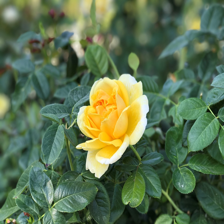

In [ ]:
# A True Positive Example

import requests
from PIL import Image
from io import BytesIO

response = requests.get("https://1.img-dpreview.com/files/p/E~C0x0S1200x900~articles/7934908715/6001875552.jpeg")
real_image_sample = Image.open(BytesIO(response.content))

sample_image_tp = np.array(real_image_sample.resize((224, 224)))
sample_image_tp

In [ ]:
# The classifier's prediction
classifier_model(sample_image_tp)

tensor([[0.9991]], device='cuda:0', grad_fn=<SigmoidBackward0>)

In [ ]:
sample_image_tp = torch.tensor(sample_image_tp, dtype=torch.float32)
sample_image_tp = sample_image_tp.clone().detach().to(device)

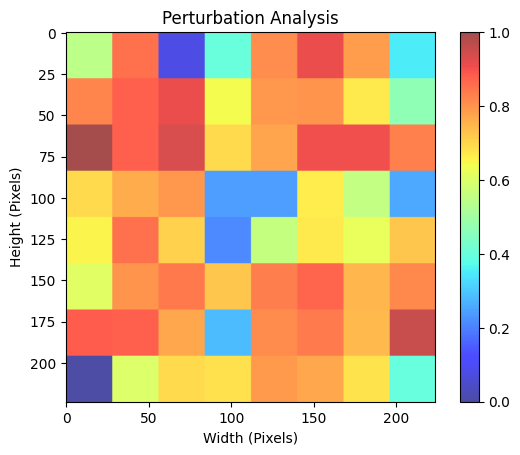

In [ ]:
perturbation_analysis_per_block(classifier_model, sample_image_tp)

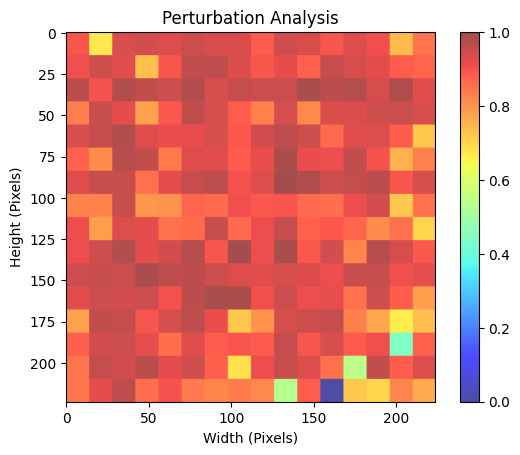

In [ ]:
perturbation_analysis_per_block(classifier_model, sample_image_tp, block_size=14)

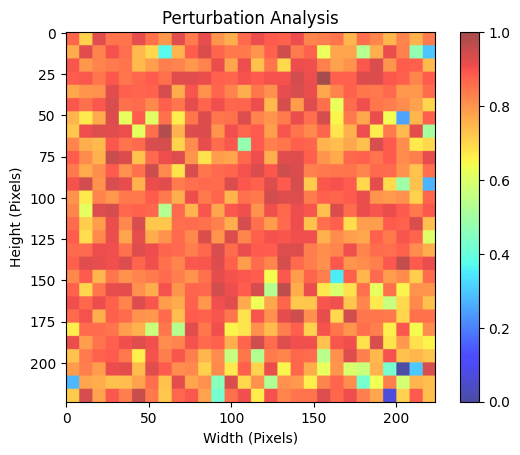

In [ ]:
perturbation_analysis_per_block(classifier_model, sample_image_tp, block_size=8)

  0%|          | 0/50 [00:00<?, ?it/s]

array([[[ 66,  43,  40],
        [ 64,  43,  42],
        [ 63,  43,  43],
        ...,
        [112,  73,  81],
        [117,  80,  79],
        [131,  94,  82]],

       [[ 67,  45,  43],
        [ 65,  44,  43],
        [ 65,  45,  44],
        ...,
        [ 82,  44,  44],
        [113,  74,  77],
        [134,  97,  87]],

       [[ 69,  46,  45],
        [ 68,  46,  45],
        [ 68,  46,  45],
        ...,
        [143, 105, 100],
        [ 90,  52,  60],
        [ 93,  59,  63]],

       ...,

       [[154, 144, 125],
        [155, 145, 125],
        [153, 143, 124],
        ...,
        [ 55,  33,  35],
        [ 53,  31,  34],
        [ 54,  32,  34]],

       [[155, 145, 126],
        [154, 144, 125],
        [156, 147, 127],
        ...,
        [ 53,  32,  34],
        [ 54,  33,  34],
        [ 55,  32,  34]],

       [[156, 146, 128],
        [156, 146, 127],
        [159, 149, 129],
        ...,
        [ 54,  32,  35],
        [ 56,  32,  35],
        [ 56,  34,  33]]], dtype=uint8)
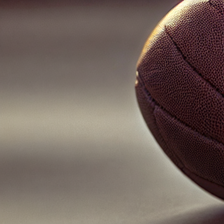

In [ ]:
# A True Negative Example

sample_image_tn = get_image_by_prompt("a football ball")
sample_image_tn

In [ ]:
# The classifier's prediction
classifier_model(sample_image_tn)

tensor([[0.0217]], device='cuda:0', grad_fn=<SigmoidBackward0>)

In [ ]:
sample_image_tn = torch.tensor(sample_image_tn, dtype=torch.float32)
sample_image_tn = sample_image_tn.clone().detach().to(device)

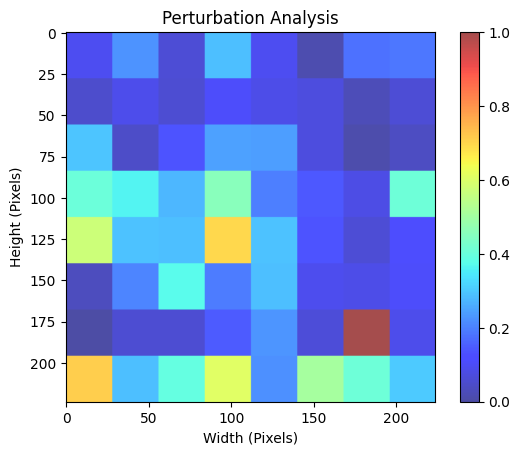

In [ ]:
perturbation_analysis_per_block(classifier_model, sample_image_tn)

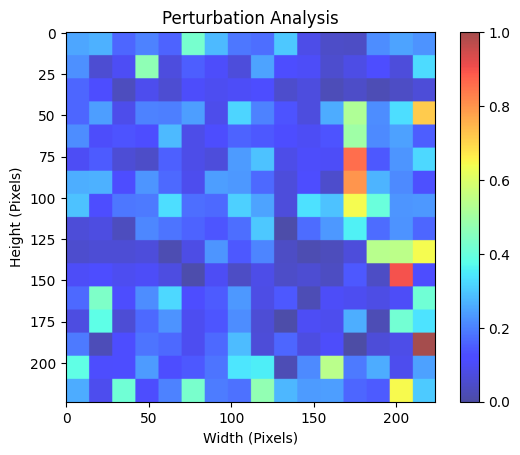

In [ ]:
perturbation_analysis_per_block(classifier_model, sample_image_tn, block_size=14)

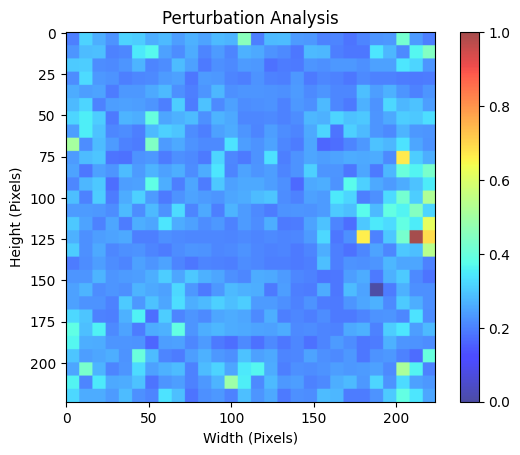

In [ ]:
perturbation_analysis_per_block(classifier_model, sample_image_tn, block_size=8)

  0%|          | 0/50 [00:00<?, ?it/s]

array([[[252, 254, 254],
        [253, 254, 254],
        [254, 254, 255],
        ...,
        [254, 255, 255],
        [254, 255, 254],
        [254, 255, 254]],

       [[252, 253, 255],
        [253, 253, 254],
        [254, 254, 255],
        ...,
        [254, 254, 254],
        [253, 254, 254],
        [254, 255, 254]],

       [[252, 253, 254],
        [253, 253, 254],
        [253, 253, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[ 55,  48,  60],
        [ 55,  51,  55],
        [ 59,  51,  53],
        ...,
        [ 79,  71,  79],
        [ 61,  59,  59],
        [ 71,  64,  61]],

       [[174, 171, 148],
        [132, 109,  81],
        [ 88,  74,  81],
        ...,
        [117,  85,  55],
        [116,  89,  54],
        [ 75,  62,  57]],

       [[154, 142,  89],
        [ 94,  56,  35],
        [ 74,  59,  70],
        ...,
        [ 93,  75,  58],
        [121,  85,  58],
        [ 95,  84,  73]]], dtype=uint8)
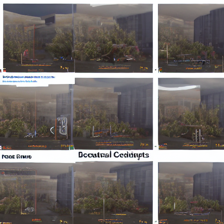

In [ ]:
# A False Positive Example
# This was a 'little' bit hard to find

sample_image_fp = get_image_by_prompt("the most realistic thing you can generate")
sample_image_fp

In [ ]:
# The classifier's prediction
classifier_model(sample_image_fp)

tensor([[0.9968]], device='cuda:0', grad_fn=<SigmoidBackward0>)

In [ ]:
sample_image_fp = torch.tensor(sample_image_fp, dtype=torch.float32)
sample_image_fp = sample_image_fp.clone().detach().to(device)

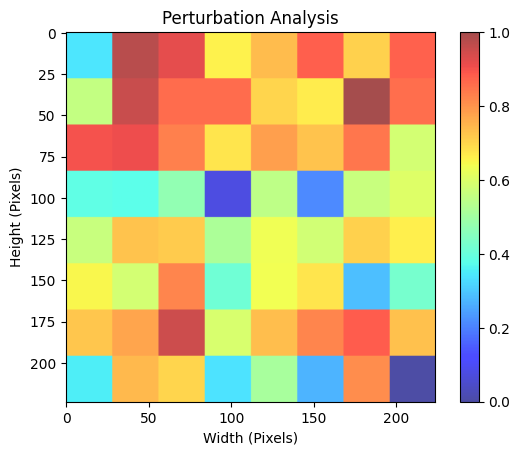

In [ ]:
perturbation_analysis_per_block(classifier_model, sample_image_fp)

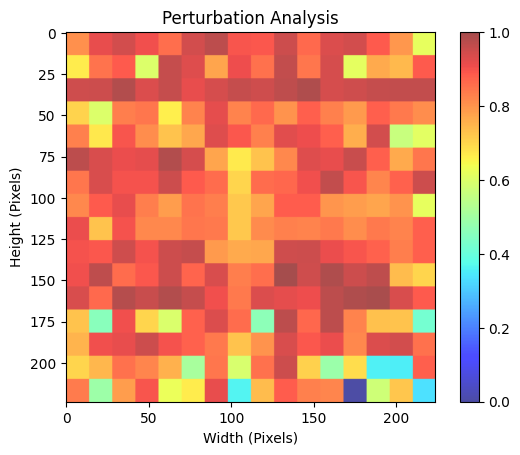

In [ ]:
perturbation_analysis_per_block(classifier_model, sample_image_fp, block_size=14)

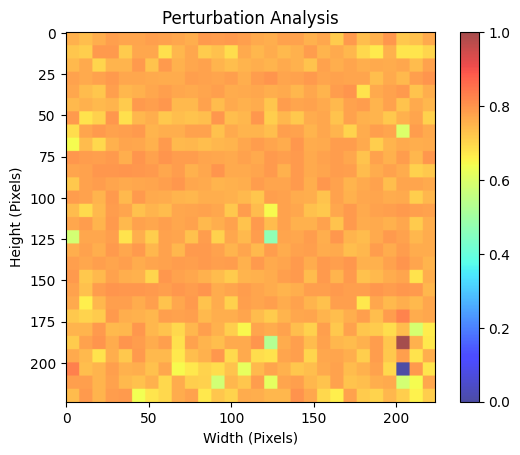

In [ ]:
perturbation_analysis_per_block(classifier_model, sample_image_fp, block_size=8)

array([[[ 35,  65,  33],
        [ 41,  71,  37],
        [ 49,  79,  43],
        ...,
        [ 15,  56,  12],
        [  8,  46,   0],
        [  1,  39,   0]],

       [[ 36,  65,  33],
        [ 42,  71,  39],
        [ 50,  78,  42],
        ...,
        [ 21,  62,  20],
        [ 15,  53,   7],
        [  8,  46,   0]],

       [[ 39,  61,  32],
        [ 44,  68,  38],
        [ 49,  75,  40],
        ...,
        [ 26,  66,  32],
        [ 18,  57,  14],
        [ 10,  48,   4]],

       ...,

       [[ 62,  40,  42],
        [ 56,  35,  37],
        [ 48,  28,  29],
        ...,
        [ 35,  56,  54],
        [ 44,  70,  67],
        [ 51,  76,  73]],

       [[ 52,  30,  32],
        [ 79,  58,  60],
        [ 65,  45,  46],
        ...,
        [ 48,  70,  68],
        [ 57,  86,  82],
        [ 55,  82,  78]],

       [[ 51,  29,  31],
        [104,  83,  85],
        [ 82,  62,  63],
        ...,
        [ 59,  81,  79],
        [ 48,  78,  74],
        [ 45,  75,  70]]], dtype=uint8)
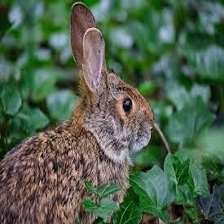

In [ ]:
# A False Negative Example

import requests
from PIL import Image
from io import BytesIO

response = requests.get("https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcRth4gBjNozN4O7GW659n5ZzpAQsVb_6U327A&s")
real_image_sample = Image.open(BytesIO(response.content))

sample_image_fn = np.array(real_image_sample.resize((224, 224)))
sample_image_fn

In [ ]:
# The classifier's prediction
classifier_model(sample_image_fn)

tensor([[0.0360]], device='cuda:0', grad_fn=<SigmoidBackward0>)

In [ ]:
sample_image_fn = torch.tensor(sample_image_fn, dtype=torch.float32)
sample_image_fn = sample_image_fn.clone().detach().to(device)

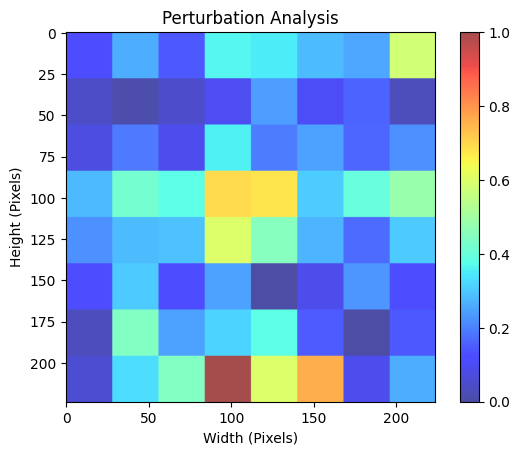

In [ ]:
perturbation_analysis_per_block(classifier_model, sample_image_fn)

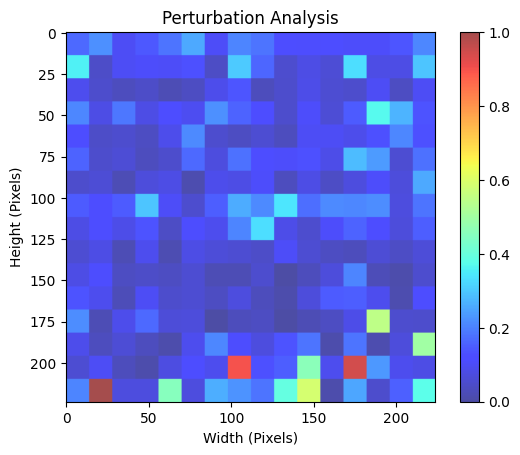

In [ ]:
perturbation_analysis_per_block(classifier_model, sample_image_fn, block_size=14)

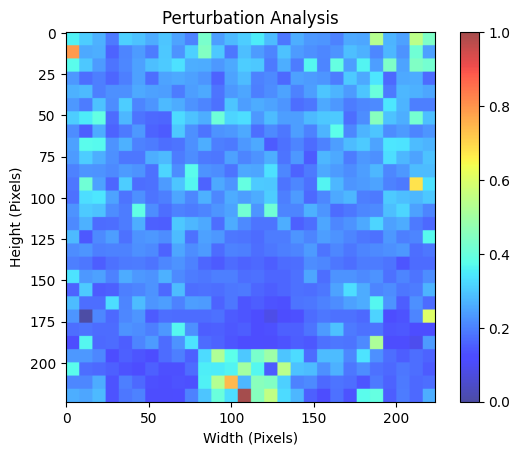

In [ ]:
perturbation_analysis_per_block(classifier_model, sample_image_fn, block_size=8)

I believe the results are pretty obvious: when the model classifies an image as fake, it looks at some small details (e.g., artifacts, inconsistencies in textures, or unnatural edges) and not the whole image. Therefore, we can confidently conclude it looks at small cursed parts of the image to determine if it is fake. Alternatively, when the model classifies an image as real it looks at the whole image, to check if there are any cursed details.

We should justify these two statements. In the images classified as 'real', most of the pixels are equally and highly important to some extent. This means the model does not care if just a part of the image is realistic, it wants the whole image to seem realistic to it. On the other hand, when the image is determined to be 'fake', there are pixels with almost no importance and pixels with really high importance. Judging from this, the model requires just a single detail to classify an image as 'generated'.

Given these two statements, we may conclude that our model is powerful as it does not require the image to be completely cursed and wants just a detail or a few to seem fake. In other words, our model seems to focus on local artifacts when detecting fake images, rather than assessing the entire image. This suggests that it can effectively pick up on small inconsistencies introduced by the generative model. Conversely, for real images, the model tends to evaluate the entire image more evenly, ensuring that no unrealistic details are present.

## 8. Summary and Findings

Throughout this notebook, we managed to **successfully perform Proof of Concept of fake image detection using Fake and Authentic Discrimination by Embeddings (FADE)**. The model shows a strong performance vs. Stable Diffusion v1.5 with an accuracy of 96% on the test set. It beats all of the models mentioned by Nan Zhong et al. (2023).

In summary, we loaded a dataset of 1,000 real images and generated a caption with the help of a transformer for each of them. Using the captions, we generated 'fake' images and fine-tuned a model to distinguish the features of real and fake images. The last step was to train a classification model.

FADE offers several benefits over other methods: achieves high accuracy and offers computational efficiency. The embedder and the classifier were trained on lower-resolution images ((224, 224)) and required a low amount of samples (1,000 per class, 2,000 in total). Another strength of FADE is that it requires minimal hyperparameter tuning. This is because the embedder is not fine-tuned until full convergence, and the classification task remains straightforward since the embedder has already learned to distinguish between the embeddings of real and fake images. As mentioned at the beginning of the notebook, the objective was not mainly to create a robust model but to test the approach (FADE). FADE can be applied using various generative models and embedders. Based on the results stated in the notebook, the method is expected to work excellently on a variety of datasets with images generated by a different model or combination of models.

## 9. Future Directions and Improvements

We cannot hide the fact the model was trained on a limited amount of data (2,000 images in total). Despite using transformers and not defining models from scratch, 2,000 samples is considered a low amount of data for deep learning tasks. The future of FADE includes training models aligning with the approach on a larger dataset. Furthermore, FADE was tested on a single generative model (Stable Diffusion v1.5), which, regardless of its proven quality, does not provide a full variety of generated images. Another future improvement will be conducting more experiments and hyperparameter tuning. During this notebook, just a few experiments were conducted as the desired accuracy was reached, which was the goal.

*P.S. Thank you for reviewing this notebook. I hope you found the presentation of FADE insightful and engaging.*

*Best regards,* <br>
*M. Shopov*

## References

[Datasets: A Community Library for Natural Language Processing](https://arxiv.org/abs/2109.02846)<br>
[PyTorch: An Imperative Style, High-Performance Deep Learning Library](https://arxiv.org/abs/1912.01703)<br>
[Transformers: State-of-the-Art Natural Language Processing](https://arxiv.org/abs/1910.03771)<br>
[Generative Adversarial Nets](https://arxiv.org/abs/1406.2661)<br>
[Generative Adversarial Networks (GANs): Challenges, Solutions, and Future Directions](https://arxiv.org/abs/2005.00065)<br>
[FaceForensics++: Learning to Detect Manipulated Facial Images](https://arxiv.org/abs/1901.08971)<br>
[ClueCatcher: Catching Domain-Wise Independent Clues for Deepfake Detection](https://www.mdpi.com/2227-7390/11/18/3952)<br>
[Rich and Poor Texture Contrast: A Simple yet Effective Approach for AI-generated Image Detection](https://arxiv.org/html/2311.12397v2)<br>
[Learning Transferable Visual Models From Natural Language Supervision](https://arxiv.org/abs/2103.00020)<br>
[bitmind/bm-real](https://huggingface.co/datasets/bitmind/bm-real)<br>
[Salesforce/blip-image-captioning-base](https://huggingface.co/Salesforce/blip-image-captioning-base)<br>
[BLIP: Bootstrapping Language-Image Pre-training for Unified Vision-Language Understanding and Generation](https://arxiv.org/abs/2201.12086)<br>
[stable-diffusion-v1-5/stable-diffusion-v1-5](https://huggingface.co/stable-diffusion-v1-5/stable-diffusion-v1-5)<br>
[High-Resolution Image Synthesis with Latent Diffusion Models](https://arxiv.org/abs/2112.10752)<br>
[microsoft/swin-tiny-patch4-window7-224](https://huggingface.co/microsoft/swin-tiny-patch4-window7-224)<br>
[Swin Transformer: Hierarchical Vision Transformer using Shifted Windows](https://arxiv.org/abs/2103.14030)<br>
[Signature Verification using a "Siamese" Time Delay Neural Network](https://papers.neurips.cc/paper_files/paper/1993/file/288cc0ff022877bd3df94bc9360b9c5d-Paper.pdf)<br>
[ADAM: A METHOD FOR STOCHASTIC OPTIMIZATION](https://arxiv.org/abs/1412.6980)<br>
[Visualizing Data using t-SNE](https://www.jmlr.org/papers/v9/vandermaaten08a.html)<br>
[PERTURBATION ANALYSIS: CONCEPTS AND ALGORITHMS](https://dl.acm.org/doi/pdf/10.1145/167293.167340)<br>
[Don’t Lie to Me! Robust and Efficient Explainability with Verified Perturbation Analysis](https://arxiv.org/abs/2202.07728)<br>
[Smooth-edged Perturbations Improve Perturbation-based Image Explanations](https://arxiv.org/html/2409.04116v1)<br>